In [5]:
!kaggle datasets download -d 'balraj98/deepglobe-road-extraction-dataset'

100% 3.78G/3.79G [00:37<00:00, 107MB/s]
100% 3.79G/3.79G [00:37<00:00, 108MB/s]


In [6]:
!unzip deepglobe-road-extraction-dataset.zip -d road-detection

Streaming output truncated to the last 5000 lines.
  inflating: road-detection/train/723199_sat.jpg  
  inflating: road-detection/train/723226_mask.png  
  inflating: road-detection/train/723226_sat.jpg  
  inflating: road-detection/train/723436_mask.png  
  inflating: road-detection/train/723436_sat.jpg  
  inflating: road-detection/train/723483_mask.png  
  inflating: road-detection/train/723483_sat.jpg  
  inflating: road-detection/train/723622_mask.png  
  inflating: road-detection/train/723622_sat.jpg  
  inflating: road-detection/train/723722_mask.png  
  inflating: road-detection/train/723722_sat.jpg  
  inflating: road-detection/train/723970_mask.png  
  inflating: road-detection/train/723970_sat.jpg  
  inflating: road-detection/train/723990_mask.png  
  inflating: road-detection/train/723990_sat.jpg  
  inflating: road-detection/train/724095_mask.png  
  inflating: road-detection/train/724095_sat.jpg  
  inflating: road-detection/train/724431_mask.png  
  inflating: road-dete

In [6]:
# CELL 1: set paths and create output folders (edit BASE_DIR if needed)
from pathlib import Path
import os

BASE_DIR = Path(r"C:\Users\R Pranav Yugan\Documents\Project1")   # <-- change if different
EXTRACTED_IMAGES = Path(r"C:\Users\R Pranav Yugan\Downloads\hold_images_labels_targets\hold\images")  # your extracted xView2 images folder
RESULT_DIR = BASE_DIR / "flood_results"
CKPT_DIR   = BASE_DIR / "old_checkpoints"   # the notebook used this name earlier; edit if your checkpoints are in another folder

# make sure result dir exists
RESULT_DIR.mkdir(parents=True, exist_ok=True)

print("BASE_DIR:", BASE_DIR)
print("EXTRACTED_IMAGES:", EXTRACTED_IMAGES.exists(), EXTRACTED_IMAGES)
print("CKPT_DIR:", CKPT_DIR.exists(), CKPT_DIR)
print("RESULT_DIR:", RESULT_DIR)


BASE_DIR: C:\Users\R Pranav Yugan\Documents\Project1
EXTRACTED_IMAGES: True C:\Users\R Pranav Yugan\Downloads\hold_images_labels_targets\hold\images
CKPT_DIR: True C:\Users\R Pranav Yugan\Documents\Project1\old_checkpoints
RESULT_DIR: C:\Users\R Pranav Yugan\Documents\Project1\flood_results


In [7]:
# CELL 2: inspect filenames in the extracted images folder
from pathlib import Path
imgs = sorted([p.name for p in EXTRACTED_IMAGES.iterdir() if p.suffix.lower() in (".png",".jpg",".jpeg",".tif",".tiff")])
print("Total image files:", len(imgs))
print("First 12 files:", imgs[:12])

# Show unique disaster prefixes (text before the last two underscore tokens)
def base_prefix(name):
    # for names like hurricane-michael_00000363_post_disaster.png -> returns 'hurricane-michael_00000363'
    for suffix in ["_pre_disaster", "_post_disaster"]:
        if suffix in name:
            return name.split(suffix)[0]
    return name

prefixes = sorted({base_prefix(n).rsplit("_",1)[0] for n in imgs})  # returns disaster group names e.g. 'hurricane-michael' or 'hurricane-harvey'
print("Example disaster groups (first 20):", prefixes[:20])

# show how many pre/post per disaster group (quick)
from collections import Counter
group_counts = Counter([('_'.join(base_prefix(n).split('_')[:-1])) for n in imgs])
print("Sample counts (first 10):", list(group_counts.items())[:10])


Total image files: 1866
First 12 files: ['guatemala-volcano_00000004_post_disaster.png', 'guatemala-volcano_00000004_pre_disaster.png', 'guatemala-volcano_00000012_post_disaster.png', 'guatemala-volcano_00000012_pre_disaster.png', 'guatemala-volcano_00000014_post_disaster.png', 'guatemala-volcano_00000014_pre_disaster.png', 'guatemala-volcano_00000020_post_disaster.png', 'guatemala-volcano_00000020_pre_disaster.png', 'guatemala-volcano_00000022_post_disaster.png', 'guatemala-volcano_00000022_pre_disaster.png', 'hurricane-florence_00000006_post_disaster.png', 'hurricane-florence_00000006_pre_disaster.png']
Example disaster groups (first 20): ['guatemala-volcano', 'hurricane-florence', 'hurricane-harvey', 'hurricane-matthew', 'hurricane-michael', 'mexico-earthquake', 'midwest-flooding', 'palu-tsunami', 'santa-rosa-wildfire', 'socal-fire']
Sample counts (first 10): [('guatemala-volcano', 10), ('hurricane-florence', 238), ('hurricane-harvey', 190), ('hurricane-matthew', 188), ('hurricane-m

In [8]:
# CELL 3: copy N pairs for a chosen disaster group into dataseplit/test/sat and after_images
import shutil, itertools
from pathlib import Path

DISASTER_GROUP = "hurricane-michael"   # <-- EDIT this to the disaster group you picked from CELL 2
N_PAIRS = 30                            # <-- EDIT how many pairs to copy (start small)

DEST_BEFORE = BASE_DIR / "dataseplit" / "test" / "sat"
DEST_AFTER  = BASE_DIR / "after_images"
DEST_BEFORE.mkdir(parents=True, exist_ok=True)
DEST_AFTER.mkdir(parents=True, exist_ok=True)

# find files matching the group
all_files = sorted([p for p in EXTRACTED_IMAGES.iterdir() if DISASTER_GROUP in p.name and p.suffix.lower() in (".png",".jpg",".jpeg")])
pre_files = sorted([p for p in all_files if "pre_disaster" in p.name])
post_files= sorted([p for p in all_files if "post_disaster" in p.name])

count = min(N_PAIRS, len(pre_files), len(post_files))
if count == 0:
    raise RuntimeError(f"No pre/post files found for group {DISASTER_GROUP}. Check CELL 2 output.")

copied_ids = []
for i in range(count):
    pre = pre_files[i]
    post = post_files[i]
    base_id = f"{DISASTER_GROUP}_{i:04d}"   # e.g., hurricane-michael_0000
    shutil.copy(pre, DEST_BEFORE / f"{base_id}_sat.jpg")
    shutil.copy(post, DEST_AFTER / f"{base_id}_sat.jpg")
    copied_ids.append(base_id)

print(f"Copied {len(copied_ids)} pairs to:")
print(" BEFORE:", DEST_BEFORE)
print(" AFTER: ", DEST_AFTER)
print("Sample IDs:", copied_ids[:6])


Copied 30 pairs to:
 BEFORE: C:\Users\R Pranav Yugan\Documents\Project1\dataseplit\test\sat
 AFTER:  C:\Users\R Pranav Yugan\Documents\Project1\after_images
Sample IDs: ['hurricane-michael_0000', 'hurricane-michael_0001', 'hurricane-michael_0002', 'hurricane-michael_0003', 'hurricane-michael_0004', 'hurricane-michael_0005']


In [9]:
import os
import shutil


input_dir = 'road-detection/train'


output_sat_dir = os.path.join(input_dir, 'sat')
output_mask_dir = os.path.join(input_dir, 'mask')

os.makedirs(output_sat_dir, exist_ok=True)
os.makedirs(output_mask_dir, exist_ok=True)


for filename in os.listdir(input_dir):
    if filename.endswith('sat.jpg'):
        shutil.move(os.path.join(input_dir, filename), os.path.join(output_sat_dir, filename))
    elif filename.endswith('mask.png'):
        shutil.move(os.path.join(input_dir, filename), os.path.join(output_mask_dir, filename))



In [2]:
%pip install split-folders

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [16]:
import splitfolders
splitfolders.ratio('road-detection/train', output="datasplit", seed=1337, ratio=(.8, 0.1,0.1))

Copying files: 12452 files [00:19, 630.95 files/s]


In [10]:
import os
from PIL import Image
from torch.utils.data import Dataset
import numpy as np
import random
import torch

class SatDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.images = os.listdir(image_dir)

    def __len__(self):
        return len(self.images)

    def __getitem__(self, index):
        img_path = os.path.join(self.image_dir, self.images[index])
        mask_path = os.path.join(self.mask_dir, self.images[index].replace("sat.jpg", "mask.png"))

        image = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")  # single-channel

        # sync randomness for image+mask augmentation
        seed = np.random.randint(2147483647)
        random.seed(seed)
        np.random.seed(seed)
        torch.manual_seed(seed)

        if self.transform is not None:
            augmented = self.transform(image=np.array(image), mask=np.array(mask))
            image = augmented['image']     # ToTensorV2 typically -> (C,H,W) float
            mask = augmented['mask']       # (H,W) numpy or tensor

            # If mask is numpy -> convert to torch
            if isinstance(mask, np.ndarray):
                mask = torch.from_numpy(mask)

            # ensure float
            mask = mask.float()

            # If mask values are 0..255 scale to 0..1
            if mask.max() > 1.0:
                mask = mask / 255.0

            # make strict binary (remove interpolation artifacts)
            mask = (mask > 0.5).float()

            # Ensure channel dimension (1, H, W)
            if mask.ndim == 2:
                mask = mask.unsqueeze(0)
        else:
            # fallback conversion if no transform
            image = torch.from_numpy(np.array(image).transpose(2,0,1)).float() / 255.0
            mask = torch.from_numpy(np.array(mask)).float()
            if mask.max() > 1.0:
                mask = mask / 255.0
            mask = (mask > 0.5).float().unsqueeze(0)

        return image, mask


In [11]:
def get_loaders(
    train_dir,
    train_maskdir,
    val_dir,
    val_maskdir,
    batch_size,
    train_transform,
    val_transform,
    num_workers=0,
    pin_memory=False,
):
    train_set = SatDataset(
        image_dir=train_dir,
        mask_dir=train_maskdir,
        transform=train_transform,

    )

    train_loader = torch.utils.data.DataLoader(
        train_set,
        batch_size=batch_size,
        num_workers=num_workers,
        pin_memory=pin_memory,
        shuffle=True,
    )

    val_set = SatDataset(
        image_dir = val_dir,
        mask_dir= val_maskdir,
        transform= val_transform
    )

    val_loader = torch.utils.data.DataLoader(
        val_set,
        batch_size=batch_size,
        num_workers=num_workers,
        pin_memory=pin_memory,
        shuffle=False,
    )

    return train_loader, val_loader

In [12]:
#from torchvision.transforms import v2
#import torch

import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose([
    A.Resize(256, 256),
    A.Rotate(limit=35, p=0.5),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.1),
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225),
                max_pixel_value=255.0),
    ToTensorV2()
])

val_transforms = A.Compose([
    A.Resize(256, 256),
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225),
                max_pixel_value=255.0),
    ToTensorV2(),
])


'''

train_transform = v2.Compose(
    [

        v2.RandomResizedCrop(size=(256, 256), antialias=True),
        #v2.RandomHorizontalFlip(p=0.5),
        v2.ToTensor(),
        v2.Normalize(mean=[0.0, 0.0, 0.0],std=[1.0, 1.0, 1.0])
    ]
)
'''


'''
train_transform = A.Compose(
        [
            A.Resize(height=256, width=256),
            A.Rotate(limit=35, p=1.0),
            A.HorizontalFlip(p=0.5),
            A.VerticalFlip(p=0.1),
            A.Normalize(
                mean=[0.0, 0.0, 0.0],
                std=[1.0, 1.0, 1.0],
                max_pixel_value=255.0,
            ),
            ToTensorV2(),
        ],
    )

val_transforms = A.Compose(
        [
            A.Resize(height=256, width=256),
            A.Normalize(
                mean=[0.0, 0.0, 0.0],
                std=[1.0, 1.0, 1.0],
                max_pixel_value=255.0,
            ),
            ToTensorV2(),
        ],
    )

'''

TRAIN_IMG_DIR = "datasplit/train/sat/"
TRAIN_MASK_DIR = "datasplit/train/mask/"

VAL_IMG_DIR = "datasplit/test/sat/"
VAL_MASK_DIR = "datasplit/test/mask/"

BATCH_SIZE= 16
PIN_MEMORY = False
NUM_WORKERS = 0

train_loader, val_loader = get_loaders(
        TRAIN_IMG_DIR,
        TRAIN_MASK_DIR,
        VAL_IMG_DIR,
        VAL_MASK_DIR,
        BATCH_SIZE,
        train_transform,
        val_transforms,
        NUM_WORKERS,
        PIN_MEMORY,
    )

C:\Users\R Pranav Yugan\AppData\Roaming\Python\Python312\site-packages\albumentations\augmentations\pixel\transforms.py:39: UserWarning: A NumPy version >=1.22.4 and <2.3.0 is required for this version of SciPy (detected version 2.3.4)
  from scipy import special


In [6]:
# Access one sample without DataLoader
sample = train_loader.dataset[0]
print(type(sample), len(sample))


<class 'tuple'> 2


In [9]:
print(NUM_WORKERS, PIN_MEMORY)


0 False


In [13]:


sample_train, sample_mask = next(iter(train_loader))

In [20]:
%pip install matplotlib

Defaulting to user installation because normal site-packages is not writeable
  Obtaining dependency information for matplotlib from https://files.pythonhosted.org/packages/45/c3/994ef20eb4154ab84cc08d033834555319e4af970165e6c8894050af0b3c/matplotlib-3.10.6-cp312-cp312-win_amd64.whl.metadata
  Obtaining dependency information for contourpy>=1.0.1 from https://files.pythonhosted.org/packages/19/e8/6026ed58a64563186a9ee3f29f41261fd1828f527dd93d33b60feca63352/contourpy-1.3.3-cp312-cp312-win_amd64.whl.metadata
  Obtaining dependency information for cycler>=0.10 from https://files.pythonhosted.org/packages/e7/05/c19819d5e3d95294a6f5947fb9b9629efb316b96de511b418c53d245aae6/cycler-0.12.1-py3-none-any.whl.metadata
  Obtaining dependency information for fonttools>=4.22.0 from https://files.pythonhosted.org/packages/46/55/3e8ac21963e130242f5a9ea2ebc57f5726d704bf4dcca89088b5b637b2d3/fonttools-4.60.0-cp312-cp312-win_amd64.whl.metadata
     ---------------------------------------- 0.0/113.8 kB ? et


[notice] A new release of pip is available: 23.2.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [14]:
import matplotlib.pyplot as plt

def get_image_tensor(loader, idx, is_mask=False):
    img = loader[idx]
    print(img.shape)
    if not is_mask and img.ndim == 3:
        img = img.permute(1, 2, 0)  # Only permute if img is 3D (C,H,W)
    # Don't permute for mask; just squeeze it if needed below
    return img



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6225708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6384108..2.6225708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179956].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179956].


torch.Size([3, 256, 256])
torch.Size([1, 256, 256])
torch.Size([3, 256, 256])
torch.Size([1, 256, 256])
torch.Size([3, 256, 256])
torch.Size([1, 256, 256])
torch.Size([3, 256, 256])
torch.Size([1, 256, 256])


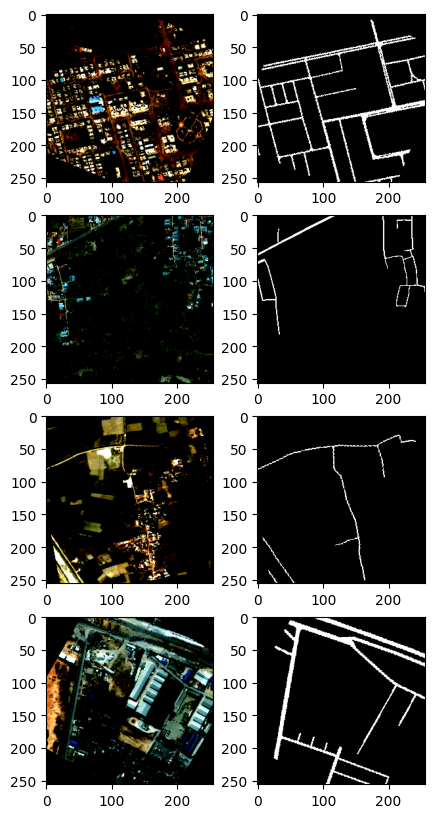

In [15]:
import matplotlib.pyplot as plt

rows = 4
current_img=0

f, ax = plt.subplots(rows,2, figsize=(5,10))


for row in range(rows):
    img = get_image_tensor(sample_train, current_img, is_mask=False)
    mask = get_image_tensor(sample_mask, current_img, is_mask=True)
    ax[row, 0].imshow(img)
    ax[row, 1].imshow(mask.squeeze(), cmap='gray')
    current_img+=1



In [7]:
%pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu121


Defaulting to user installation because normal site-packages is not writeable
Looking in indexes: https://download.pytorch.org/whl/cu121
Note: you may need to restart the kernel to use updated packages.


In [16]:
import torch.nn as nn


class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DoubleConv, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),

            nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
    def forward(self, X):
        return self.conv(X)

In [17]:
class UNET(nn.Module):
    def __init__(self, in_channels=3, out_channels=1, features=[64, 128, 256, 512]):
        super(UNET, self).__init__()
        self.ups = nn.ModuleList()
        self.downs =nn.ModuleList()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

        for feature in features:
            self.downs.append(DoubleConv(in_channels, feature))
            in_channels = feature

        for feature in reversed(features):
            self.ups.append(nn.ConvTranspose2d(in_channels=feature*2, out_channels= feature, kernel_size=2, stride=2)) # multiply feature by 2 to account for skip connection
            self.ups.append(DoubleConv(feature*2, feature))

        self.bottleneck = DoubleConv(in_channels=features[-1], out_channels=features[-1]*2)
        self.final=  nn.Conv2d(features[0], out_channels=out_channels, kernel_size=1)

    def forward(self, X):
        skip_connections = []
        for i, down in enumerate(self.downs):
            X = down(X)
            skip_connections.append(X)
            X = self.pool(X)


        X = self.bottleneck(X)
        skip_connections = list(reversed(skip_connections))


        for i in range(0, len(self.ups), 2):
            X = self.ups[i](X)
            skip_conn = skip_connections[i//2]
            #if X.shape != skip_conn.shape:
                #X = TF.resize(X, size=skip_conn.shape[2:])

            concat_skip = torch.cat((skip_conn,X), dim=1)
            X = self.ups[i+1](concat_skip)

        finalX = self.final(X)
        return self.final(X)

In [18]:
def check_accuracy(loader, model, device="cuda"):
    num_correct = 0
    num_pixels = 0
    dice_score = 0.0
    model.eval()

    with torch.no_grad():
        for x, y in loader:
            x = x.to(device)
            y = y.to(device).float()   # expect (B,1,H,W)
            preds = torch.sigmoid(model(x))
            preds = (preds > 0.5).float()

            num_correct += int((preds == y).sum().item())
            num_pixels += preds.numel()

            # compute per-batch dice and accumulate as float
            batch_dice = (2.0 * (preds * y).sum()) / ((preds + y).sum() + 1e-8)
            dice_score += float(batch_dice.item())

    acc = (num_correct / num_pixels) * 100.0 if num_pixels > 0 else 0.0
    avg_dice = dice_score / len(loader) if len(loader) > 0 else 0.0

    print(f"Got {num_correct}/{num_pixels} with acc {acc:.2f}")
    print(f"Dice score: {avg_dice:.6f}")
    model.train()
    return avg_dice


In [19]:
def train_fn(loader, model, optimizer, loss_fn, scaler):
    loop = tqdm(loader)
    model.train()
    # use model device so function works without passing device everywhere
    device = next(model.parameters()).device

    for batch_idx, (data, targets) in enumerate(loop):
        data = data.to(device)
        targets = targets.float().to(device)   # dataset returns (B,1,H,W)

        with torch.cuda.amp.autocast():
            predictions = model(data)         # (B,1,H,W) logits
            loss = loss_fn(predictions, targets)

        optimizer.zero_grad()
        scaler.scale(loss).backward()

        # unscale then clip gradients (stabilizes AMP training)
        scaler.unscale_(optimizer)
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)

        scaler.step(optimizer)
        scaler.update()

        loop.set_postfix(loss=loss.item())


In [20]:
import torchvision

def save_checkpoint(state, filename="my_checkpoint.pth.tar"):
    print("=> Saving checkpoint")
    directory = os.path.dirname(filename)
    if not os.path.exists(directory) and directory != '':
        os.makedirs(directory)
    torch.save(state, filename)

def load_checkpoint(checkpoint, model):
    print("=> Loading checkpoint")
    model.load_state_dict(checkpoint["state_dict"])

def save_predictions_as_imgs(
    loader, model, folder="saved_images", device="cuda"
):
    import os
    if not os.path.exists(folder):
        os.makedirs(folder)
        
    model.eval()
    for idx, (x, y) in enumerate(loader):
        x = x.to(device=device)
        with torch.no_grad():
            preds = torch.sigmoid(model(x))
            preds = (preds > 0.5).float()
            
        print(f"y shape before save: {y.shape}, preds shape: {preds.shape}")
        
        for batch_i in range(preds.shape[0]):
            torchvision.utils.save_image(preds[batch_i], f"{folder}/pred_{idx*preds.shape[0]+batch_i}.png")
            torchvision.utils.save_image(y[batch_i], f"{folder}/{idx*preds.shape[0]+batch_i}.png")


    model.train()

In [28]:
import torch
print(torch.__version__)
print(torch.version.cuda)
print(torch.cuda.is_available())
if torch.cuda.is_available():
    print(torch.cuda.get_device_name(0))


2.5.1+cu121
12.1
True
NVIDIA GeForce RTX 4050 Laptop GPU


In [10]:
%pip install tqdm


Defaulting to user installation because normal site-packages is not writeable
  Obtaining dependency information for tqdm from https://files.pythonhosted.org/packages/d0/30/dc54f88dd4a2b5dc8a0279bdd7270e735851848b762aeb1c1184ed1f6b14/tqdm-4.67.1-py3-none-any.whl.metadata
     ---------------------------------------- 0.0/57.7 kB ? eta -:--:--
     ------- -------------------------------- 10.2/57.7 kB ? eta -:--:--
     -------------------------- ----------- 41.0/57.7 kB 393.8 kB/s eta 0:00:01
     -------------------------------------- 57.7/57.7 kB 504.6 kB/s eta 0:00:00
   ---------------------------------------- 0.0/78.5 kB ? eta -:--:--
   ------------------------------- -------- 61.4/78.5 kB 1.7 MB/s eta 0:00:01
   ---------------------------------------- 78.5/78.5 kB 1.1 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.2.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [17]:
import torch.optim as optim
from tqdm import tqdm
import torch
import torch.nn as nn

LEARNING_RATE = 1e-3        # keep this for your custom UNET
NUM_EPOCHS = 70             # train longer so model learns thin roads
EARLY_STOPPING_PATIENCE = 10
LOAD_CHECKPOINT = True

model = UNET(in_channels=3, out_channels=1).to('cuda')

# ----- Loss Functions -----
class DiceLoss(nn.Module):
    def __init__(self, smooth=1.0):
        super().__init__()
        self.smooth = smooth

    def forward(self, logits, targets):
        probs = torch.sigmoid(logits)
        probs_flat = probs.view(probs.size(0), -1)
        targets_flat = targets.view(targets.size(0), -1)
        intersection = (probs_flat * targets_flat).sum(1)
        dice = (2.0 * intersection + self.smooth) / (
            probs_flat.sum(1) + targets_flat.sum(1) + self.smooth
        )
        return 1.0 - dice.mean()

class BCEDiceLoss(nn.Module):
    def __init__(self, pos_weight=None):
        super().__init__()
        self.bce = nn.BCEWithLogitsLoss(pos_weight=pos_weight)
        self.dice = DiceLoss()

    def forward(self, logits, targets):
        return self.bce(logits, targets) + self.dice(logits, targets)

loss_fn = BCEDiceLoss()

# ----- Optimizer & Scheduler -----
optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE, weight_decay=1e-6)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(
    optimizer, mode='max', factor=0.5, patience=4, verbose=True
)

# ----- Load checkpoint if needed -----
if LOAD_CHECKPOINT:
    print("loading checkpoints")
    load_checkpoint(
        torch.load("C:/Users/R Pranav Yugan/Documents/Project1/checkpoints/epoch_9_checkpoint.pth.tar"),
        model
    )
    print("loaded checkpoint from gdrive")

check_accuracy(val_loader, model, device='cuda')
scaler = torch.cuda.amp.GradScaler()

# ----- Training Loop with Early Stopping -----
best_val = 0.0
epochs_no_improve = 0

for epoch in range(NUM_EPOCHS):
    print(f"\nEpoch [{epoch+1}/{NUM_EPOCHS}]")
    train_fn(train_loader, model, optimizer, loss_fn, scaler)

    # save checkpoint every epoch
    checkpoint = {
        "state_dict": model.state_dict(),
        "optimizer": optimizer.state_dict(),
    }
    save_checkpoint(checkpoint, filename=f'checkpoints/epoch_{epoch}_checkpoint.pth.tar')
    print(f"Checkpoint saved for epoch {epoch}")

    # validation
    val_dice = check_accuracy(val_loader, model, device='cuda')
    print(f"Validation Dice score: {val_dice:.4f}")

    scheduler.step(val_dice)

    if val_dice > best_val + 1e-4:
        best_val = val_dice
        epochs_no_improve = 0
        print("✅ New best model")
    else:
        epochs_no_improve += 1

    if epochs_no_improve >= EARLY_STOPPING_PATIENCE:
        print(f"⏹ Early stopping triggered at epoch {epoch+1}")
        break

    save_predictions_as_imgs(val_loader, model, folder="saved_images", device='cuda')


loading checkpoints


C:\Users\R Pranav Yugan\AppData\Local\Temp\ipykernel_59280\495977407.py:50: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  torch.load("C:/Users/R Pranav Yugan/Documents/Proje

=> Loading checkpoint
loaded checkpoint from gdrive


C:\Users\R Pranav Yugan\AppData\Local\Temp\ipykernel_59280\495977407.py:56: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = torch.cuda.amp.GradScaler()


Got 39874483/40894464 with acc 97.51
Dice score: 0.676566

Epoch [1/70]


  0%|          | 0/312 [00:00<?, ?it/s]C:\Users\R Pranav Yugan\AppData\Local\Temp\ipykernel_59280\806231112.py:11: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():
100%|██████████| 312/312 [04:37<00:00,  1.12it/s, loss=0.415]


=> Saving checkpoint
Checkpoint saved for epoch 0
Got 39798728/40894464 with acc 97.32
Dice score: 0.677385
Validation Dice score: 0.6774
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 2

100%|██████████| 312/312 [04:22<00:00,  1.19it/s, loss=0.486]


=> Saving checkpoint
Checkpoint saved for epoch 1
Got 39718078/40894464 with acc 97.12
Dice score: 0.687771
Validation Dice score: 0.6878
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 2

100%|██████████| 312/312 [04:26<00:00,  1.17it/s, loss=0.305]


=> Saving checkpoint
Checkpoint saved for epoch 2
Got 39855048/40894464 with acc 97.46
Dice score: 0.699004
Validation Dice score: 0.6990
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 2

100%|██████████| 312/312 [04:17<00:00,  1.21it/s, loss=0.505]


=> Saving checkpoint
Checkpoint saved for epoch 3
Got 39821225/40894464 with acc 97.38
Dice score: 0.705608
Validation Dice score: 0.7056
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 2

100%|██████████| 312/312 [04:31<00:00,  1.15it/s, loss=0.612]


=> Saving checkpoint
Checkpoint saved for epoch 4
Got 39798707/40894464 with acc 97.32
Dice score: 0.700094
Validation Dice score: 0.7001
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape

100%|██████████| 312/312 [04:23<00:00,  1.19it/s, loss=0.428]


=> Saving checkpoint
Checkpoint saved for epoch 5
Got 39823648/40894464 with acc 97.38
Dice score: 0.707290
Validation Dice score: 0.7073
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 2

100%|██████████| 312/312 [04:23<00:00,  1.19it/s, loss=0.534]


=> Saving checkpoint
Checkpoint saved for epoch 6
Got 39868037/40894464 with acc 97.49
Dice score: 0.703367
Validation Dice score: 0.7034
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape

100%|██████████| 312/312 [04:31<00:00,  1.15it/s, loss=0.575]


=> Saving checkpoint
Checkpoint saved for epoch 7
Got 39851980/40894464 with acc 97.45
Dice score: 0.714053
Validation Dice score: 0.7141
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 2

100%|██████████| 312/312 [04:27<00:00,  1.17it/s, loss=0.328]


=> Saving checkpoint
Checkpoint saved for epoch 8
Got 39819162/40894464 with acc 97.37
Dice score: 0.703524
Validation Dice score: 0.7035
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape

100%|██████████| 312/312 [04:25<00:00,  1.17it/s, loss=0.412]


=> Saving checkpoint
Checkpoint saved for epoch 9
Got 39755959/40894464 with acc 97.22
Dice score: 0.698529
Validation Dice score: 0.6985
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape

100%|██████████| 312/312 [04:24<00:00,  1.18it/s, loss=0.278]


=> Saving checkpoint
Checkpoint saved for epoch 10
Got 39896035/40894464 with acc 97.56
Dice score: 0.718953
Validation Dice score: 0.7190
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 

100%|██████████| 312/312 [04:34<00:00,  1.14it/s, loss=0.556]


=> Saving checkpoint
Checkpoint saved for epoch 11
Got 39895886/40894464 with acc 97.56
Dice score: 0.712189
Validation Dice score: 0.7122
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:37<00:00,  1.13it/s, loss=0.577]


=> Saving checkpoint
Checkpoint saved for epoch 12
Got 39857399/40894464 with acc 97.46
Dice score: 0.712995
Validation Dice score: 0.7130
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:35<00:00,  1.13it/s, loss=0.352]


=> Saving checkpoint
Checkpoint saved for epoch 13
Got 39909897/40894464 with acc 97.59
Dice score: 0.714125
Validation Dice score: 0.7141
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:25<00:00,  1.17it/s, loss=0.5]  


=> Saving checkpoint
Checkpoint saved for epoch 14
Got 39862853/40894464 with acc 97.48
Dice score: 0.712859
Validation Dice score: 0.7129
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:29<00:00,  1.16it/s, loss=0.291]


=> Saving checkpoint
Checkpoint saved for epoch 15
Got 39893127/40894464 with acc 97.55
Dice score: 0.723481
Validation Dice score: 0.7235
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 

100%|██████████| 312/312 [04:25<00:00,  1.18it/s, loss=0.456]


=> Saving checkpoint
Checkpoint saved for epoch 16
Got 39844740/40894464 with acc 97.43
Dice score: 0.712914
Validation Dice score: 0.7129
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:28<00:00,  1.16it/s, loss=0.495]


=> Saving checkpoint
Checkpoint saved for epoch 17
Got 39895153/40894464 with acc 97.56
Dice score: 0.722901
Validation Dice score: 0.7229
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:33<00:00,  1.14it/s, loss=0.415]


=> Saving checkpoint
Checkpoint saved for epoch 18
Got 39838396/40894464 with acc 97.42
Dice score: 0.716804
Validation Dice score: 0.7168
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:33<00:00,  1.14it/s, loss=0.339]


=> Saving checkpoint
Checkpoint saved for epoch 19
Got 39873803/40894464 with acc 97.50
Dice score: 0.724061
Validation Dice score: 0.7241
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 

100%|██████████| 312/312 [06:16<00:00,  1.21s/it, loss=0.527]


=> Saving checkpoint
Checkpoint saved for epoch 20
Got 39965095/40894464 with acc 97.73
Dice score: 0.729524
Validation Dice score: 0.7295
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 

100%|██████████| 312/312 [06:46<00:00,  1.30s/it, loss=0.576]


=> Saving checkpoint
Checkpoint saved for epoch 21
Got 39940451/40894464 with acc 97.67
Dice score: 0.717960
Validation Dice score: 0.7180
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [06:37<00:00,  1.27s/it, loss=0.394]


=> Saving checkpoint
Checkpoint saved for epoch 22
Got 39815316/40894464 with acc 97.36
Dice score: 0.712495
Validation Dice score: 0.7125
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [06:36<00:00,  1.27s/it, loss=0.347]


=> Saving checkpoint
Checkpoint saved for epoch 23
Got 39861732/40894464 with acc 97.47
Dice score: 0.732206
Validation Dice score: 0.7322
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 

100%|██████████| 312/312 [06:26<00:00,  1.24s/it, loss=0.434]


=> Saving checkpoint
Checkpoint saved for epoch 24
Got 39900026/40894464 with acc 97.57
Dice score: 0.721409
Validation Dice score: 0.7214
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [06:29<00:00,  1.25s/it, loss=0.496]


=> Saving checkpoint
Checkpoint saved for epoch 25
Got 39913066/40894464 with acc 97.60
Dice score: 0.726933
Validation Dice score: 0.7269
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [06:04<00:00,  1.17s/it, loss=0.394]


=> Saving checkpoint
Checkpoint saved for epoch 26
Got 39929375/40894464 with acc 97.64
Dice score: 0.718714
Validation Dice score: 0.7187
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [05:48<00:00,  1.12s/it, loss=0.478]


=> Saving checkpoint
Checkpoint saved for epoch 27
Got 39935237/40894464 with acc 97.65
Dice score: 0.728508
Validation Dice score: 0.7285
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [05:48<00:00,  1.12s/it, loss=0.461]


=> Saving checkpoint
Checkpoint saved for epoch 28
Got 39924711/40894464 with acc 97.63
Dice score: 0.731023
Validation Dice score: 0.7310
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:45<00:00,  1.09it/s, loss=0.41] 


=> Saving checkpoint
Checkpoint saved for epoch 29
Got 39971501/40894464 with acc 97.74
Dice score: 0.749237
Validation Dice score: 0.7492
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 

100%|██████████| 312/312 [04:32<00:00,  1.15it/s, loss=0.387]


=> Saving checkpoint
Checkpoint saved for epoch 30
Got 39985506/40894464 with acc 97.78
Dice score: 0.748251
Validation Dice score: 0.7483
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:18<00:00,  1.21it/s, loss=0.527]


=> Saving checkpoint
Checkpoint saved for epoch 31
Got 39965504/40894464 with acc 97.73
Dice score: 0.748180
Validation Dice score: 0.7482
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:23<00:00,  1.19it/s, loss=0.393]


=> Saving checkpoint
Checkpoint saved for epoch 32
Got 39976292/40894464 with acc 97.75
Dice score: 0.745623
Validation Dice score: 0.7456
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:21<00:00,  1.19it/s, loss=0.421]


=> Saving checkpoint
Checkpoint saved for epoch 33
Got 39980245/40894464 with acc 97.76
Dice score: 0.750089
Validation Dice score: 0.7501
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 

100%|██████████| 312/312 [04:29<00:00,  1.16it/s, loss=0.323]


=> Saving checkpoint
Checkpoint saved for epoch 34
Got 39939504/40894464 with acc 97.66
Dice score: 0.745131
Validation Dice score: 0.7451
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:18<00:00,  1.21it/s, loss=0.315]


=> Saving checkpoint
Checkpoint saved for epoch 35
Got 40012220/40894464 with acc 97.84
Dice score: 0.750803
Validation Dice score: 0.7508
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 

100%|██████████| 312/312 [04:26<00:00,  1.17it/s, loss=0.269]


=> Saving checkpoint
Checkpoint saved for epoch 36
Got 39960136/40894464 with acc 97.72
Dice score: 0.745046
Validation Dice score: 0.7450
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:21<00:00,  1.19it/s, loss=0.368]


=> Saving checkpoint
Checkpoint saved for epoch 37
Got 39968052/40894464 with acc 97.73
Dice score: 0.744329
Validation Dice score: 0.7443
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:33<00:00,  1.14it/s, loss=0.406]


=> Saving checkpoint
Checkpoint saved for epoch 38
Got 39997710/40894464 with acc 97.81
Dice score: 0.750879
Validation Dice score: 0.7509
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:29<00:00,  1.16it/s, loss=0.463]


=> Saving checkpoint
Checkpoint saved for epoch 39
Got 40027742/40894464 with acc 97.88
Dice score: 0.751797
Validation Dice score: 0.7518
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 

100%|██████████| 312/312 [04:33<00:00,  1.14it/s, loss=0.338]


=> Saving checkpoint
Checkpoint saved for epoch 40
Got 39990442/40894464 with acc 97.79
Dice score: 0.754525
Validation Dice score: 0.7545
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 

100%|██████████| 312/312 [04:32<00:00,  1.14it/s, loss=0.295]


=> Saving checkpoint
Checkpoint saved for epoch 41
Got 39972562/40894464 with acc 97.75
Dice score: 0.748451
Validation Dice score: 0.7485
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:22<00:00,  1.19it/s, loss=0.313]


=> Saving checkpoint
Checkpoint saved for epoch 42
Got 40001685/40894464 with acc 97.82
Dice score: 0.750473
Validation Dice score: 0.7505
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:31<00:00,  1.15it/s, loss=0.306]


=> Saving checkpoint
Checkpoint saved for epoch 43
Got 40010822/40894464 with acc 97.84
Dice score: 0.753886
Validation Dice score: 0.7539
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:23<00:00,  1.19it/s, loss=0.227]


=> Saving checkpoint
Checkpoint saved for epoch 44
Got 39997526/40894464 with acc 97.81
Dice score: 0.751694
Validation Dice score: 0.7517
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:23<00:00,  1.19it/s, loss=0.391]


=> Saving checkpoint
Checkpoint saved for epoch 45
Got 40008678/40894464 with acc 97.83
Dice score: 0.756453
Validation Dice score: 0.7565
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 

100%|██████████| 312/312 [04:32<00:00,  1.14it/s, loss=0.563]


=> Saving checkpoint
Checkpoint saved for epoch 46
Got 40016369/40894464 with acc 97.85
Dice score: 0.753384
Validation Dice score: 0.7534
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:28<00:00,  1.16it/s, loss=0.446]


=> Saving checkpoint
Checkpoint saved for epoch 47
Got 39994670/40894464 with acc 97.80
Dice score: 0.758017
Validation Dice score: 0.7580
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 

100%|██████████| 312/312 [04:21<00:00,  1.19it/s, loss=0.285]


=> Saving checkpoint
Checkpoint saved for epoch 48
Got 39997901/40894464 with acc 97.81
Dice score: 0.747943
Validation Dice score: 0.7479
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:31<00:00,  1.15it/s, loss=0.414]


=> Saving checkpoint
Checkpoint saved for epoch 49
Got 40007672/40894464 with acc 97.83
Dice score: 0.757777
Validation Dice score: 0.7578
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:30<00:00,  1.15it/s, loss=0.301]


=> Saving checkpoint
Checkpoint saved for epoch 50
Got 40033028/40894464 with acc 97.89
Dice score: 0.757197
Validation Dice score: 0.7572
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:31<00:00,  1.15it/s, loss=0.258]


=> Saving checkpoint
Checkpoint saved for epoch 51
Got 39935290/40894464 with acc 97.65
Dice score: 0.746066
Validation Dice score: 0.7461
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:33<00:00,  1.14it/s, loss=0.342]


=> Saving checkpoint
Checkpoint saved for epoch 52
Got 40004095/40894464 with acc 97.82
Dice score: 0.756735
Validation Dice score: 0.7567
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:27<00:00,  1.17it/s, loss=0.412]


=> Saving checkpoint
Checkpoint saved for epoch 53
Got 40030094/40894464 with acc 97.89
Dice score: 0.762169
Validation Dice score: 0.7622
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 

100%|██████████| 312/312 [04:33<00:00,  1.14it/s, loss=0.317]


=> Saving checkpoint
Checkpoint saved for epoch 54
Got 40015866/40894464 with acc 97.85
Dice score: 0.762862
Validation Dice score: 0.7629
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 

100%|██████████| 312/312 [04:33<00:00,  1.14it/s, loss=0.54] 


=> Saving checkpoint
Checkpoint saved for epoch 55
Got 40045330/40894464 with acc 97.92
Dice score: 0.757421
Validation Dice score: 0.7574
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:25<00:00,  1.18it/s, loss=0.378]


=> Saving checkpoint
Checkpoint saved for epoch 56
Got 40054218/40894464 with acc 97.95
Dice score: 0.762938
Validation Dice score: 0.7629
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:33<00:00,  1.14it/s, loss=0.318]


=> Saving checkpoint
Checkpoint saved for epoch 57
Got 40046528/40894464 with acc 97.93
Dice score: 0.764329
Validation Dice score: 0.7643
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 

100%|██████████| 312/312 [04:24<00:00,  1.18it/s, loss=0.348]


=> Saving checkpoint
Checkpoint saved for epoch 58
Got 40030893/40894464 with acc 97.89
Dice score: 0.760807
Validation Dice score: 0.7608
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:28<00:00,  1.16it/s, loss=0.394]


=> Saving checkpoint
Checkpoint saved for epoch 59
Got 40056795/40894464 with acc 97.95
Dice score: 0.765971
Validation Dice score: 0.7660
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 

100%|██████████| 312/312 [04:32<00:00,  1.14it/s, loss=0.271]


=> Saving checkpoint
Checkpoint saved for epoch 60
Got 40046563/40894464 with acc 97.93
Dice score: 0.764940
Validation Dice score: 0.7649
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:29<00:00,  1.16it/s, loss=0.347]


=> Saving checkpoint
Checkpoint saved for epoch 61
Got 40000933/40894464 with acc 97.82
Dice score: 0.759000
Validation Dice score: 0.7590
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:32<00:00,  1.14it/s, loss=0.276]


=> Saving checkpoint
Checkpoint saved for epoch 62
Got 40046557/40894464 with acc 97.93
Dice score: 0.766362
Validation Dice score: 0.7664
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 

100%|██████████| 312/312 [06:41<00:00,  1.29s/it, loss=0.337]


=> Saving checkpoint
Checkpoint saved for epoch 63
Got 40056211/40894464 with acc 97.95
Dice score: 0.765063
Validation Dice score: 0.7651
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [07:35<00:00,  1.46s/it, loss=0.316]


=> Saving checkpoint
Checkpoint saved for epoch 64
Got 40050354/40894464 with acc 97.94
Dice score: 0.764984
Validation Dice score: 0.7650
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [07:38<00:00,  1.47s/it, loss=0.34] 


=> Saving checkpoint
Checkpoint saved for epoch 65
Got 40061703/40894464 with acc 97.96
Dice score: 0.764539
Validation Dice score: 0.7645
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:36<00:00,  1.13it/s, loss=0.315]


=> Saving checkpoint
Checkpoint saved for epoch 66
Got 40058191/40894464 with acc 97.96
Dice score: 0.765178
Validation Dice score: 0.7652
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [04:29<00:00,  1.16it/s, loss=0.266]


=> Saving checkpoint
Checkpoint saved for epoch 67
Got 40072790/40894464 with acc 97.99
Dice score: 0.762999
Validation Dice score: 0.7630
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

100%|██████████| 312/312 [05:19<00:00,  1.03s/it, loss=0.361]


=> Saving checkpoint
Checkpoint saved for epoch 68
Got 40057777/40894464 with acc 97.95
Dice score: 0.768706
Validation Dice score: 0.7687
✅ New best model
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 

100%|██████████| 312/312 [05:23<00:00,  1.04s/it, loss=0.362]


=> Saving checkpoint
Checkpoint saved for epoch 69
Got 40070230/40894464 with acc 97.98
Dice score: 0.767302
Validation Dice score: 0.7673
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shape before save: torch.Size([16, 1, 256, 256]), preds shape: torch.Size([16, 1, 256, 256])
y shap

In [21]:
from pathlib import Path
import os

# Paths to your xView2 dataset
XVIEW2_BASE = Path(r"C:\Users\R Pranav Yugan\Documents\Project1\disaster_data")
XVIEW2_IMAGES = XVIEW2_BASE / "images"
XVIEW2_LABELS = XVIEW2_BASE / "labels"

# Output directory for damage detection results
DAMAGE_OUTPUT = Path(r"C:\Users\R Pranav Yugan\Documents\Project1\road_damage_results")
DAMAGE_OUTPUT.mkdir(exist_ok=True, parents=True)

# Checkpoint path - use your best trained model
CHECKPOINT_PATH = r"C:/Users/R Pranav Yugan/Documents/Project1/old_checkpoints/epoch_68_checkpoint.pth.tar"

print(f"xView2 images folder exists: {XVIEW2_IMAGES.exists()}")
print(f"xView2 labels folder exists: {XVIEW2_LABELS.exists()}")
print(f"Checkpoint exists: {Path(CHECKPOINT_PATH).exists()}")


xView2 images folder exists: True
xView2 labels folder exists: True
Checkpoint exists: True


In [22]:
import torch
import torch.nn as nn

# Load model
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
model = UNET(in_channels=3, out_channels=1).to(DEVICE)

# Load checkpoint
checkpoint = torch.load(CHECKPOINT_PATH, map_location=DEVICE)
model.load_state_dict(checkpoint["state_dict"])
model.eval()

print(f"Model loaded from {CHECKPOINT_PATH}")
print(f"Using device: {DEVICE}")


C:\Users\R Pranav Yugan\AppData\Local\Temp\ipykernel_91772\3776702874.py:9: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(CHECKPOINT_PATH, map_locati

Model loaded from C:/Users/R Pranav Yugan/Documents/Project1/old_checkpoints/epoch_68_checkpoint.pth.tar
Using device: cuda


In [30]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
import cv2
import numpy as np
from PIL import Image

# Transform for inference
infer_transform = A.Compose([
    A.Resize(256, 256),
    A.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0], max_pixel_value=255.0),
    ToTensorV2(),
])

def predict_road_mask(image_path, model, device, threshold=0.15):
    """
    Predict road segmentation mask with RELAXED threshold for disaster imagery
    """
    # Load image
    image = np.array(Image.open(image_path).convert("RGB"))
    original_size = (image.shape[0], image.shape[1])
    
    # Apply transform
    augmented = infer_transform(image=image)
    image_tensor = augmented["image"].unsqueeze(0).to(device)
    
    # Predict
    with torch.no_grad():
        preds = torch.sigmoid(model(image_tensor))
        preds = preds.cpu().numpy()[0, 0]  # (H, W)
    
    # Resize back to original size
    prob_mask = cv2.resize(preds, (original_size[1], original_size[0]))
    
    # VERY LOW threshold (0.15 instead of 0.5)
    binary_mask = (prob_mask > threshold).astype(np.uint8)
    
    # Morphological operations to clean up and connect road segments
    kernel_close = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
    binary_mask = cv2.morphologyEx(binary_mask, cv2.MORPH_CLOSE, kernel_close, iterations=2)
    
    # Remove tiny noise
    kernel_open = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
    binary_mask = cv2.morphologyEx(binary_mask, cv2.MORPH_OPEN, kernel_open)
    
    # Fill small holes
    binary_mask = cv2.morphologyEx(binary_mask, cv2.MORPH_CLOSE, kernel_open)
    
    return binary_mask, prob_mask

print("✓ Enhanced prediction function ready with threshold=0.15!")


✓ Enhanced prediction function ready with threshold=0.15!


In [31]:
def detect_road_damage(pre_image_path, post_image_path, model, device, threshold=0.15):
    """
    Detect damaged/missing roads with relaxed threshold
    """
    # Get road masks for both images
    pre_mask, pre_prob = predict_road_mask(pre_image_path, model, device, threshold)
    post_mask, post_prob = predict_road_mask(post_image_path, model, device, threshold)
    
    # Damage = roads present before but missing after
    damage_mask = np.logical_and(pre_mask == 1, post_mask == 0).astype(np.uint8)
    
    # More aggressive morphological operations
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
    damage_mask = cv2.morphologyEx(damage_mask, cv2.MORPH_OPEN, kernel)
    damage_mask = cv2.morphologyEx(damage_mask, cv2.MORPH_CLOSE, kernel)
    
    # Calculate metrics
    total_pre_roads = np.sum(pre_mask)
    total_post_roads = np.sum(post_mask)
    total_damage = np.sum(damage_mask)
    
    damage_percentage = (total_damage / total_pre_roads * 100) if total_pre_roads > 0 else 0
    
    metrics = {
        "pre_road_pixels": int(total_pre_roads),
        "post_road_pixels": int(total_post_roads),
        "damaged_pixels": int(total_damage),
        "damage_percentage": round(damage_percentage, 2),
        "road_survival_rate": round((total_post_roads / total_pre_roads * 100) if total_pre_roads > 0 else 0, 2)
    }
    
    return damage_mask, pre_mask, post_mask, metrics

print("✓ Enhanced damage detection function ready!")


✓ Enhanced damage detection function ready!


In [32]:
import matplotlib.pyplot as plt

def visualize_damage(pre_image_path, post_image_path, pre_mask, post_mask, damage_mask, metrics, save_path=None):
    """
    Create visualization of road damage detection results
    """
    # Load original images
    pre_img = np.array(Image.open(pre_image_path).convert("RGB"))
    post_img = np.array(Image.open(post_image_path).convert("RGB"))
    
    # Create overlay images
    pre_overlay = pre_img.copy()
    post_overlay = post_img.copy()
    damage_overlay = post_img.copy()
    
    # Green for intact roads, red for damage
    pre_overlay[pre_mask == 1] = [0, 255, 0]  # Green
    post_overlay[post_mask == 1] = [0, 0, 255]  # Blue
    damage_overlay[damage_mask == 1] = [255, 0, 0]  # Red for damage
    damage_overlay[post_mask == 1] = [0, 255, 0]  # Green for surviving roads
    
    # Blend overlays
    pre_blend = cv2.addWeighted(pre_img, 0.6, pre_overlay, 0.4, 0)
    post_blend = cv2.addWeighted(post_img, 0.6, post_overlay, 0.4, 0)
    damage_blend = cv2.addWeighted(post_img, 0.6, damage_overlay, 0.4, 0)
    
    # Plot
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    
    axes[0, 0].imshow(pre_img)
    axes[0, 0].set_title("Pre-Disaster Image", fontsize=14)
    axes[0, 0].axis("off")
    
    axes[0, 1].imshow(post_img)
    axes[0, 1].set_title("Post-Disaster Image", fontsize=14)
    axes[0, 1].axis("off")
    
    axes[0, 2].imshow(damage_mask, cmap="Reds")
    axes[0, 2].set_title("Damage Mask", fontsize=14)
    axes[0, 2].axis("off")
    
    axes[1, 0].imshow(pre_blend)
    axes[1, 0].set_title("Pre-Disaster Roads (Green)", fontsize=14)
    axes[1, 0].axis("off")
    
    axes[1, 1].imshow(post_blend)
    axes[1, 1].set_title("Post-Disaster Roads (Blue)", fontsize=14)
    axes[1, 1].axis("off")
    
    axes[1, 2].imshow(damage_blend)
    axes[1, 2].set_title(f"Damage Overlay\nDamage: {metrics['damage_percentage']:.1f}%", fontsize=14, color="red")
    axes[1, 2].axis("off")
    
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=150, bbox_inches="tight")
        print(f"Saved visualization to {save_path}")
    
    plt.show()

print("Visualization function ready!")


Visualization function ready!


In [33]:
from tqdm import tqdm
import pandas as pd

def process_disaster_dataset(images_folder, model, device, output_folder, max_samples=50):
    """
    Process disaster image pairs with LIMIT to save time
    """
    images_folder = Path(images_folder)
    output_folder = Path(output_folder)
    output_folder.mkdir(exist_ok=True, parents=True)
    
    # Find all image files
    all_images = sorted(images_folder.glob("*.png")) + sorted(images_folder.glob("*.jpg"))
    
    # Group into pre-post pairs
    pre_images = [img for img in all_images if "_pre_" in img.name or "pre_disaster" in img.name]
    
    # LIMIT to first N samples to save time
    pre_images = pre_images[:max_samples]
    
    results = []
    
    print(f"Processing {len(pre_images)} pre-disaster images (limited to {max_samples})")
    
    for pre_path in tqdm(pre_images, desc="Processing image pairs"):
        # Find corresponding post image
        post_name = pre_path.name.replace("_pre_", "_post_").replace("pre_disaster", "post_disaster")
        post_path = images_folder / post_name
        
        if not post_path.exists():
            print(f"⚠ Warning: No post image found for {pre_path.name}")
            continue
        
        # Detect damage
        try:
            damage_mask, pre_mask, post_mask, metrics = detect_road_damage(
                pre_path, post_path, model, device, threshold=0.15
            )
            
            # Save results
            sample_id = pre_path.stem.replace("_pre_disaster", "").replace("_sat", "")
            
            # Save masks
            cv2.imwrite(str(output_folder / f"{sample_id}_pre_mask.png"), pre_mask * 255)
            cv2.imwrite(str(output_folder / f"{sample_id}_post_mask.png"), post_mask * 255)
            cv2.imwrite(str(output_folder / f"{sample_id}_damage_mask.png"), damage_mask * 255)
            
            # Save visualization only for images with detected roads
            if metrics['pre_road_pixels'] > 100:  # Only visualize if roads detected
                viz_path = output_folder / f"{sample_id}_visualization.png"
                visualize_damage(pre_path, post_path, pre_mask, post_mask, damage_mask, metrics, save_path=viz_path)
                plt.close()
            
            # Store metrics
            results.append({
                "sample_id": sample_id,
                "pre_image": pre_path.name,
                "post_image": post_path.name,
                **metrics
            })
            
        except Exception as e:
            print(f"❌ Error processing {pre_path.name}: {e}")
            continue
    
    # Save summary CSV
    df = pd.DataFrame(results)
    csv_path = output_folder / "damage_detection_summary.csv"
    df.to_csv(csv_path, index=False)
    
    print(f"\n{'='*60}")
    print(f"✓ Summary saved to {csv_path}")
    print(f"✓ Processed {len(results)} image pairs")
    print(f"✓ Results saved to {output_folder}")
    print(f"{'='*60}")
    
    return df

print("✓ Batch processing function ready (limited to 50 samples)!")


✓ Batch processing function ready (limited to 50 samples)!


In [29]:
# CELL 52: DIAGNOSTIC - Check first processed result
import numpy as np

sample_pre = XVIEW2_IMAGES / "guatemala-volcano_00000004_pre_disaster.png"
sample_post = XVIEW2_IMAGES / "guatemala-volcano_00000004_post_disaster.png"

# Test with different thresholds
for thresh in [0.3, 0.4, 0.5, 0.6]:
    _, pre_prob = predict_road_mask(sample_pre, model, DEVICE, threshold=thresh)
    _, post_prob = predict_road_mask(sample_post, model, DEVICE, threshold=thresh)
    
    pre_pixels = np.sum(pre_prob > thresh)
    post_pixels = np.sum(post_prob > thresh)
    
    print(f"Threshold {thresh}: Pre={pre_pixels} pixels, Post={post_pixels} pixels")


Threshold 0.3: Pre=31 pixels, Post=0 pixels
Threshold 0.4: Pre=12 pixels, Post=0 pixels
Threshold 0.5: Pre=2 pixels, Post=0 pixels
Threshold 0.6: Pre=0 pixels, Post=0 pixels


Starting road damage detection pipeline...
Processing 50 pre-disaster images (limited to 50)


Processing image pairs:   0%|          | 0/50 [00:00<?, ?it/s]

Saved visualization to C:\Users\R Pranav Yugan\Documents\Project1\road_damage_results\guatemala-volcano_00000004_visualization.png


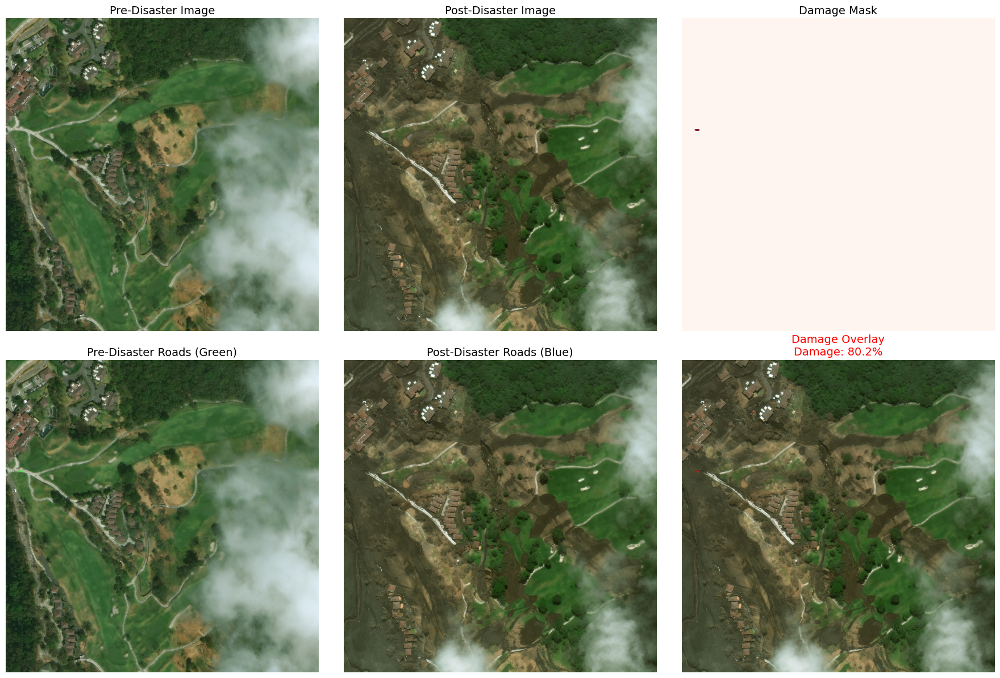

Processing image pairs:  18%|█▊        | 9/50 [00:06<00:09,  4.44it/s]

Saved visualization to C:\Users\R Pranav Yugan\Documents\Project1\road_damage_results\hurricane-florence_00000014_visualization.png


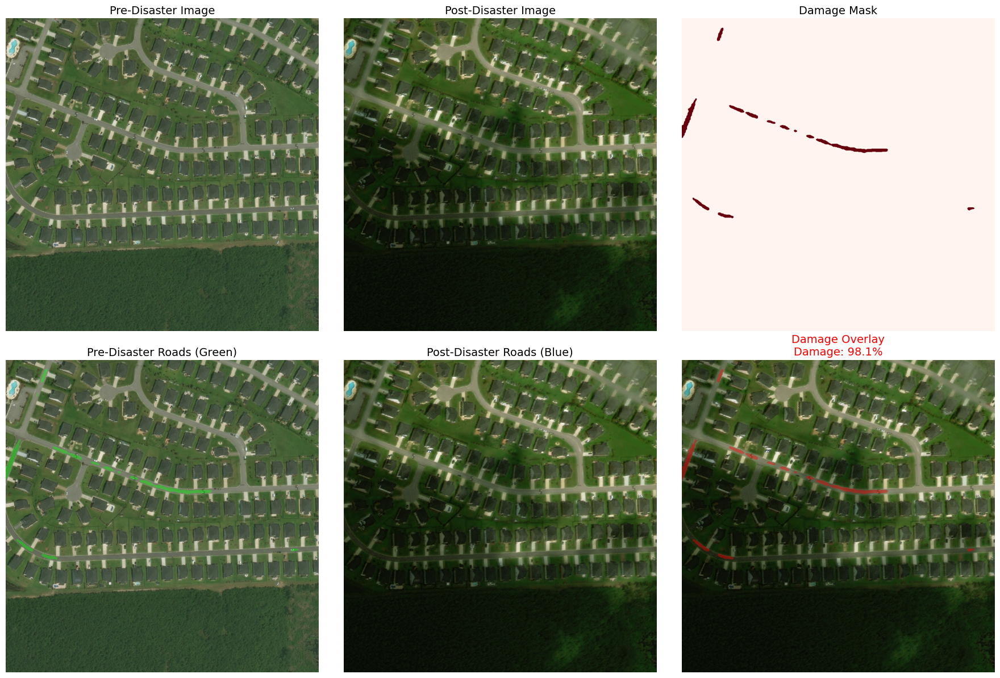

Processing image pairs:  28%|██▊       | 14/50 [00:11<00:16,  2.19it/s]

Saved visualization to C:\Users\R Pranav Yugan\Documents\Project1\road_damage_results\hurricane-florence_00000034_visualization.png


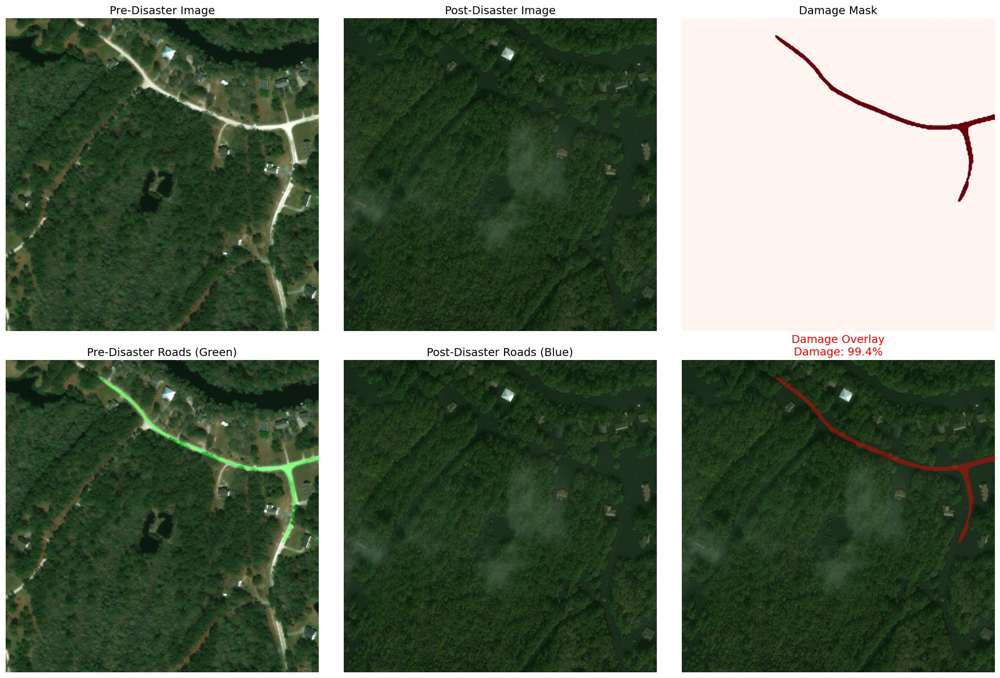

Processing image pairs:  34%|███▍      | 17/50 [00:16<00:29,  1.11it/s]

Saved visualization to C:\Users\R Pranav Yugan\Documents\Project1\road_damage_results\hurricane-florence_00000040_visualization.png


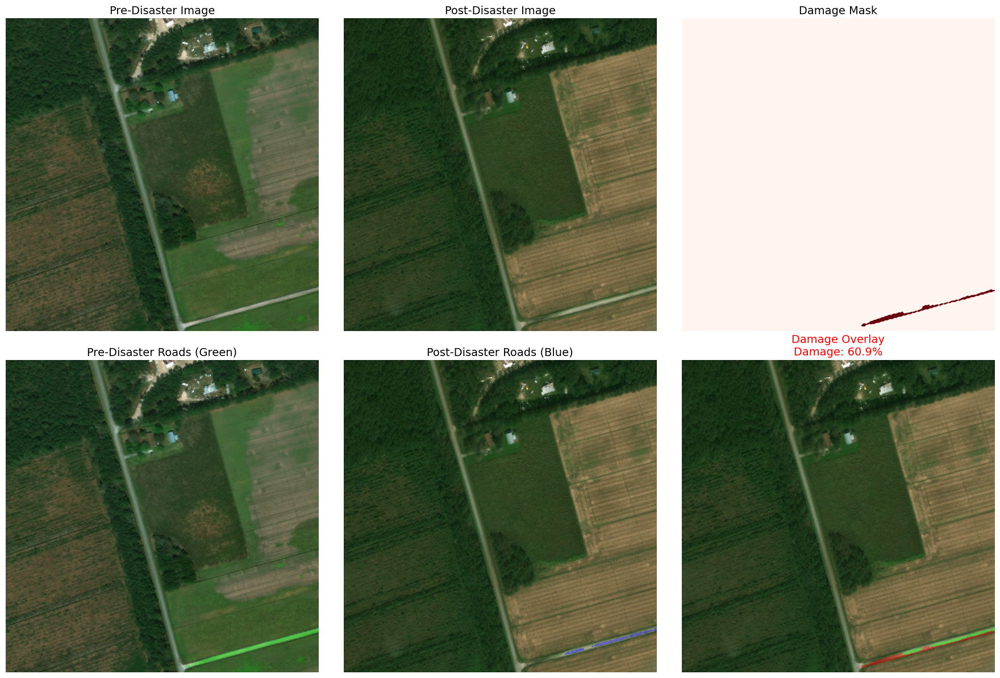

Processing image pairs:  40%|████      | 20/50 [00:20<00:30,  1.00s/it]

Saved visualization to C:\Users\R Pranav Yugan\Documents\Project1\road_damage_results\hurricane-florence_00000050_visualization.png


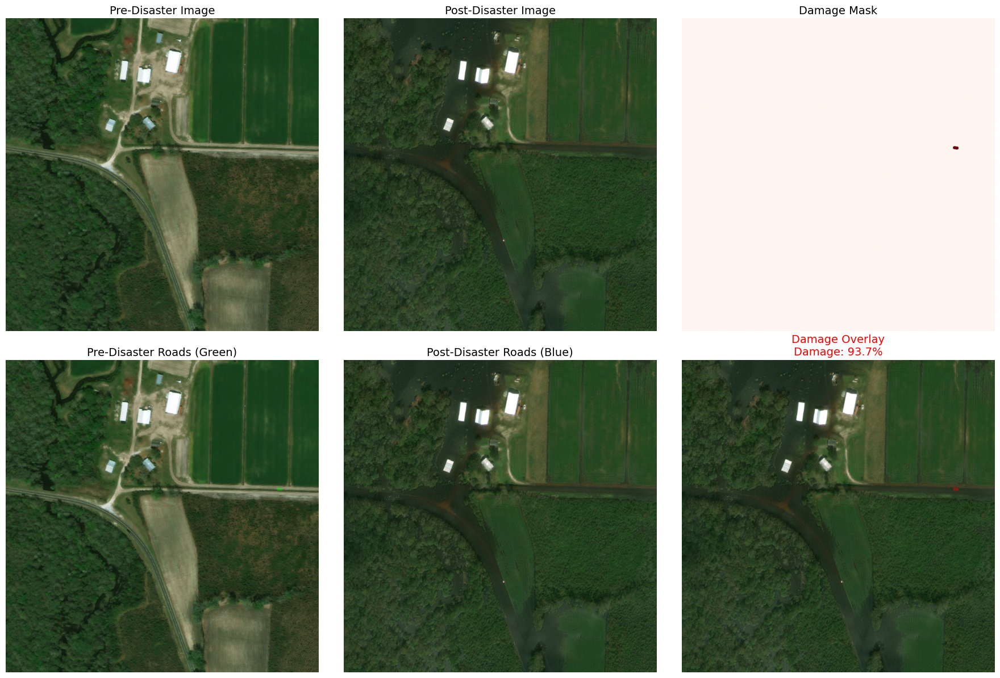

Processing image pairs:  42%|████▏     | 21/50 [00:25<00:57,  1.98s/it]

Saved visualization to C:\Users\R Pranav Yugan\Documents\Project1\road_damage_results\hurricane-florence_00000052_visualization.png


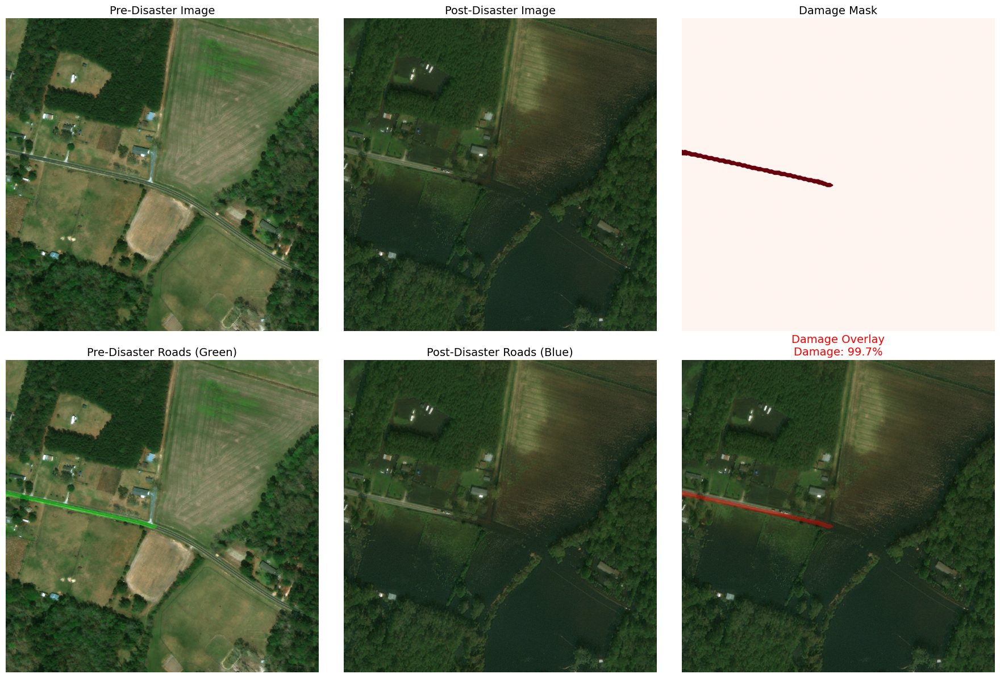

Processing image pairs:  52%|█████▏    | 26/50 [00:30<00:17,  1.35it/s]

Saved visualization to C:\Users\R Pranav Yugan\Documents\Project1\road_damage_results\hurricane-florence_00000089_visualization.png


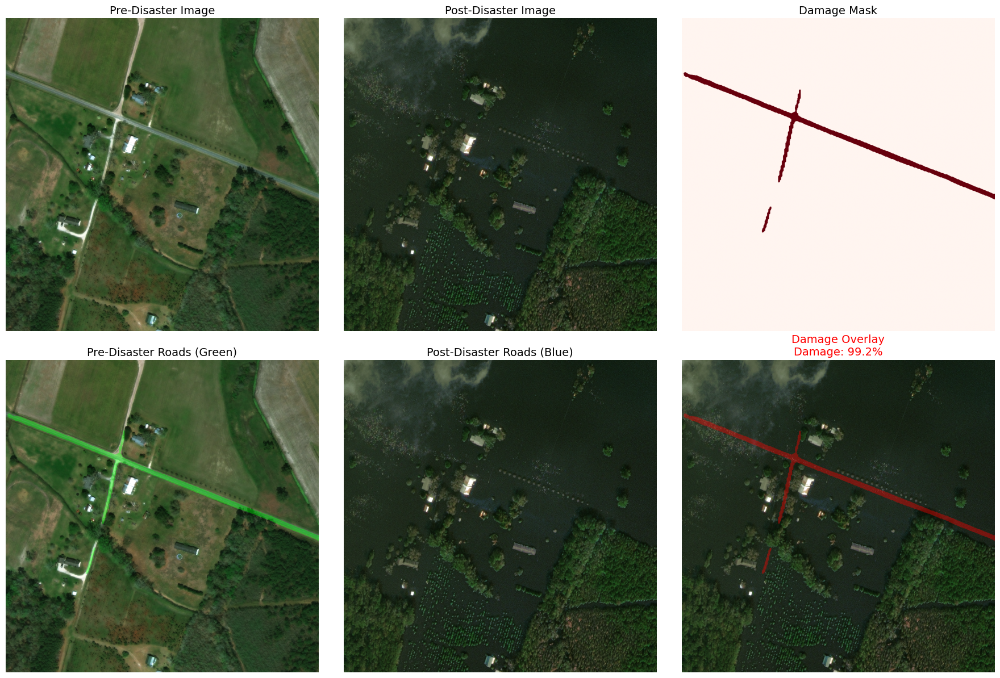

Processing image pairs:  66%|██████▌   | 33/50 [00:35<00:05,  3.01it/s]

Saved visualization to C:\Users\R Pranav Yugan\Documents\Project1\road_damage_results\hurricane-florence_00000109_visualization.png


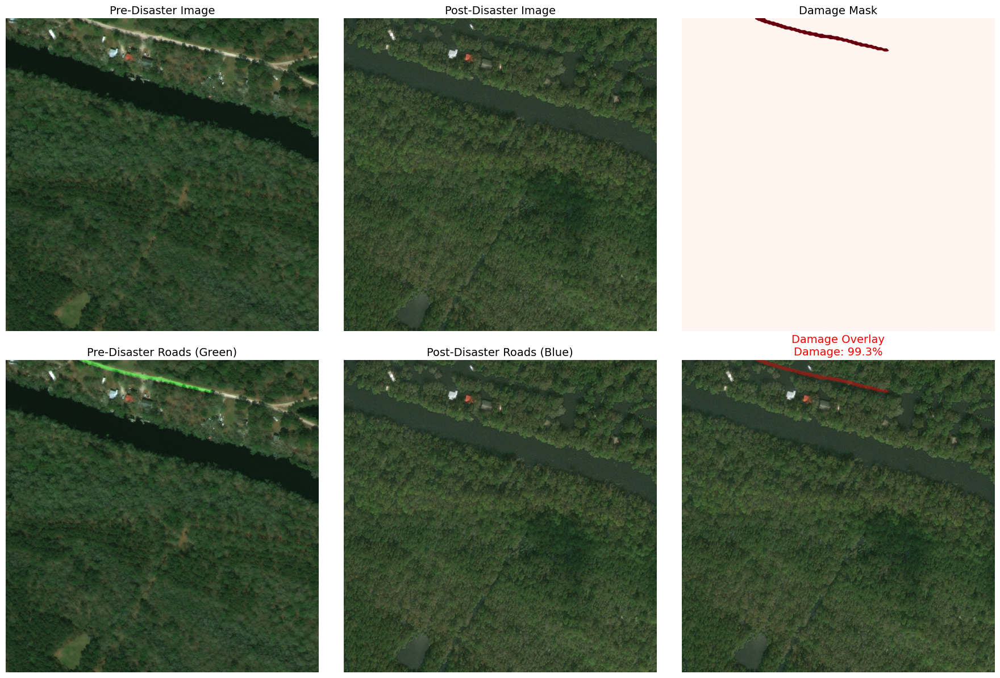

Processing image pairs:  78%|███████▊  | 39/50 [00:40<00:04,  2.75it/s]

Saved visualization to C:\Users\R Pranav Yugan\Documents\Project1\road_damage_results\hurricane-florence_00000154_visualization.png


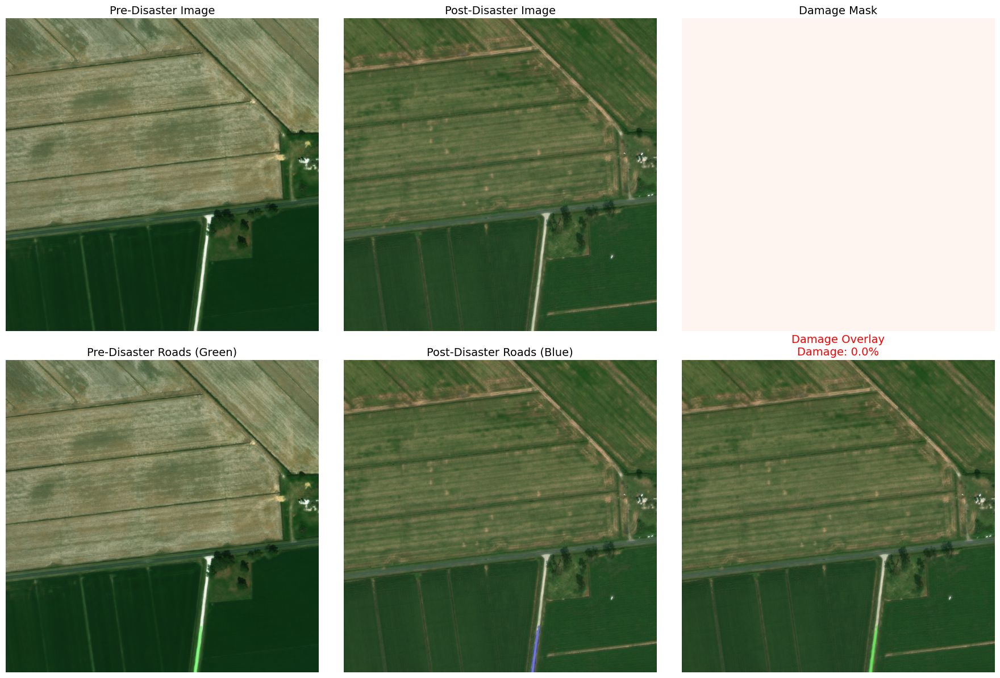

Processing image pairs:  90%|█████████ | 45/50 [00:45<00:01,  2.53it/s]

Saved visualization to C:\Users\R Pranav Yugan\Documents\Project1\road_damage_results\hurricane-florence_00000175_visualization.png


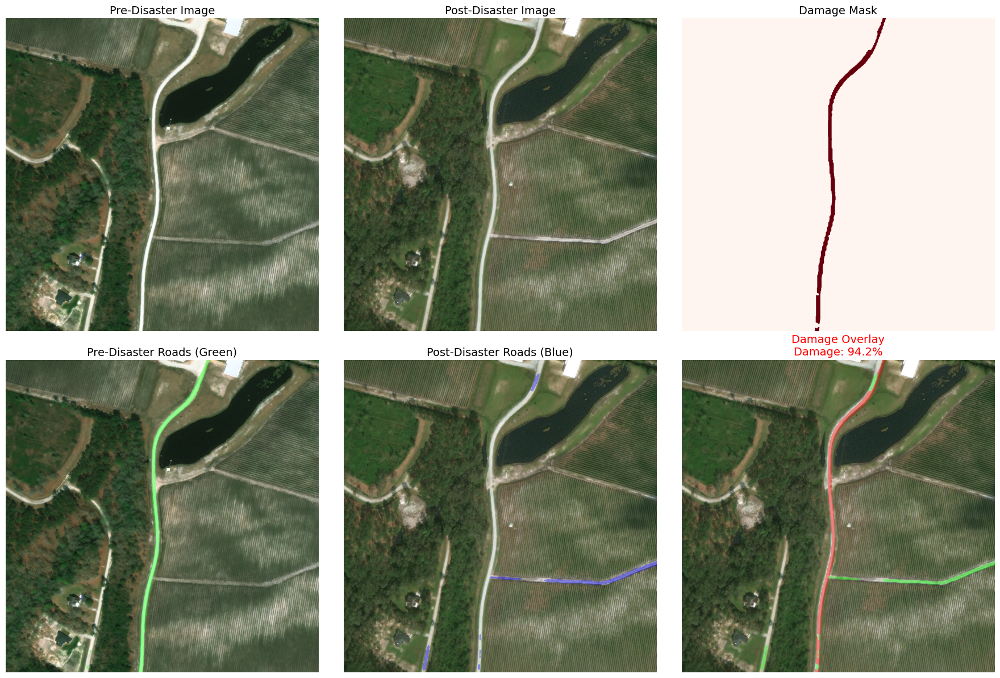

Processing image pairs:  94%|█████████▍| 47/50 [00:50<00:04,  1.40s/it]

Saved visualization to C:\Users\R Pranav Yugan\Documents\Project1\road_damage_results\hurricane-florence_00000201_visualization.png


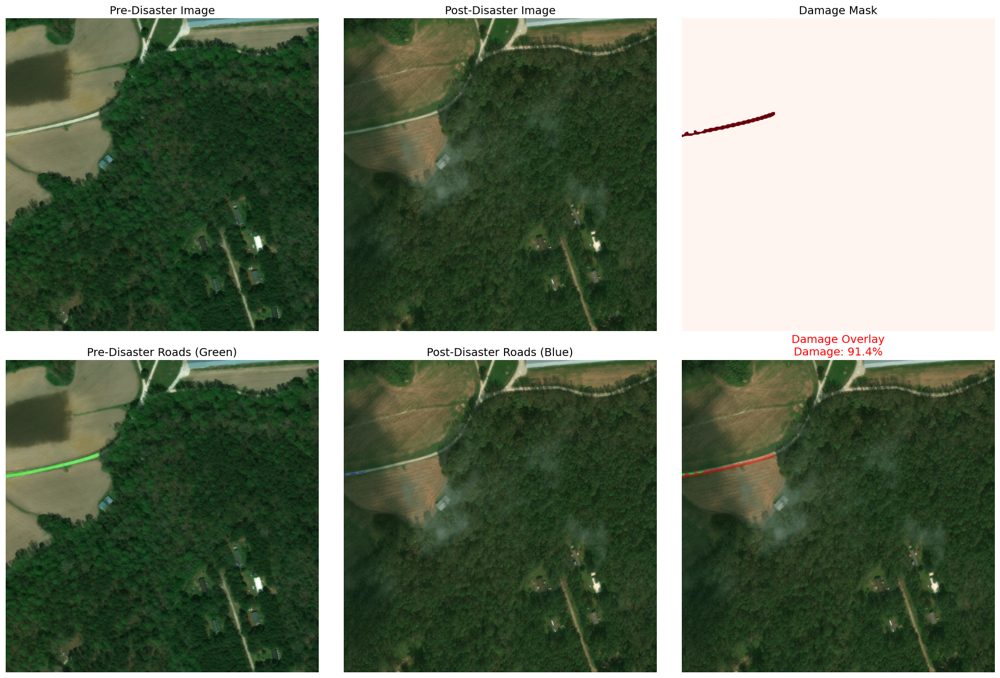

Processing image pairs: 100%|██████████| 50/50 [00:57<00:00,  1.16s/it]


✓ Summary saved to C:\Users\R Pranav Yugan\Documents\Project1\road_damage_results\damage_detection_summary.csv
✓ Processed 50 image pairs
✓ Results saved to C:\Users\R Pranav Yugan\Documents\Project1\road_damage_results

DAMAGE DETECTION SUMMARY
       pre_road_pixels  post_road_pixels  damaged_pixels  damage_percentage  \
count        50.000000           50.0000        50.00000          50.000000   
mean       1661.340000          311.0800      1546.72000          18.324000   
std        4425.680626         1196.9916      4313.35154          37.395619   
min           0.000000            0.0000         0.00000           0.000000   
25%           0.000000            0.0000         0.00000           0.000000   
50%           0.000000            0.0000         0.00000           0.000000   
75%           0.000000            0.0000         0.00000           0.000000   
max       21492.000000         6882.0000     21321.00000          99.730000   

       road_survival_rate  
count        

In [34]:
# RUN THE COMPLETE PIPELINE
print("Starting road damage detection pipeline...")
print("="*60)

results_df = process_disaster_dataset(
    images_folder=XVIEW2_IMAGES,
    model=model,
    device=DEVICE,
    output_folder=DAMAGE_OUTPUT,
    max_samples=50  # Process only 50 pairs to save time
)

# Display summary statistics
print("\n" + "="*60)
print("DAMAGE DETECTION SUMMARY")
print("="*60)
print(results_df.describe())

# Show top 10 most damaged locations
print("\n" + "="*60)
print("TOP 10 MOST DAMAGED LOCATIONS")
print("="*60)
damaged_df = results_df[results_df['damage_percentage'] > 0]
if len(damaged_df) > 0:
    print(damaged_df.nlargest(min(10, len(damaged_df)), "damage_percentage")[["sample_id", "damage_percentage", "road_survival_rate"]])
else:
    print("No significant damage detected in processed samples")

# Show statistics
print("\n" + "="*60)
print("OVERALL STATISTICS")
print("="*60)
print(f"Total samples processed: {len(results_df)}")
print(f"Samples with roads detected: {len(results_df[results_df['pre_road_pixels'] > 100])}")
print(f"Samples with damage > 10%: {len(results_df[results_df['damage_percentage'] > 10])}")
print(f"Average damage percentage: {results_df['damage_percentage'].mean():.2f}%")
print(f"Average road survival rate: {results_df['road_survival_rate'].mean():.2f}%")


ROAD DAMAGE ANALYSIS: hurricane-florence_00000089

--- DAMAGE STATISTICS ---
Pre-disaster road pixels: 21,492
Post-disaster road pixels: 0
Damaged road pixels: 21,321
Damage percentage: 99.20%

--- MODEL PERFORMANCE ---
Overall Accuracy: 97.95%
Total pixels analyzed: 1,048,576
Correctly classified pixels: 1,027,084

--- DISASTER IMPACT ASSESSMENT ---
🔴 Impact Level: CATASTROPHIC
🔴 Description: Almost complete destruction of road network
🔴 99.2% of road network damaged/destroyed

⚠️  EMERGENCY RESPONSE REQUIRED:
   • Major road network disruption
   • Emergency vehicle access severely limited
   • Immediate infrastructure repair needed
   • Alternative routes must be established

VISUALIZATION


C:\Users\R Pranav Yugan\AppData\Local\Temp\ipykernel_91772\170212574.py:112: UserWarning: Glyph 128308 (\N{LARGE RED CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\R Pranav Yugan\AppData\Local\Temp\ipykernel_91772\170212574.py:113: UserWarning: Glyph 128308 (\N{LARGE RED CIRCLE}) missing from font(s) DejaVu Sans.
  plt.savefig(DAMAGE_OUTPUT / f"{SAMPLE_ID}_final_result.png",
C:\Users\R Pranav Yugan\AppData\Roaming\Python\Python312\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128308 (\N{LARGE RED CIRCLE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


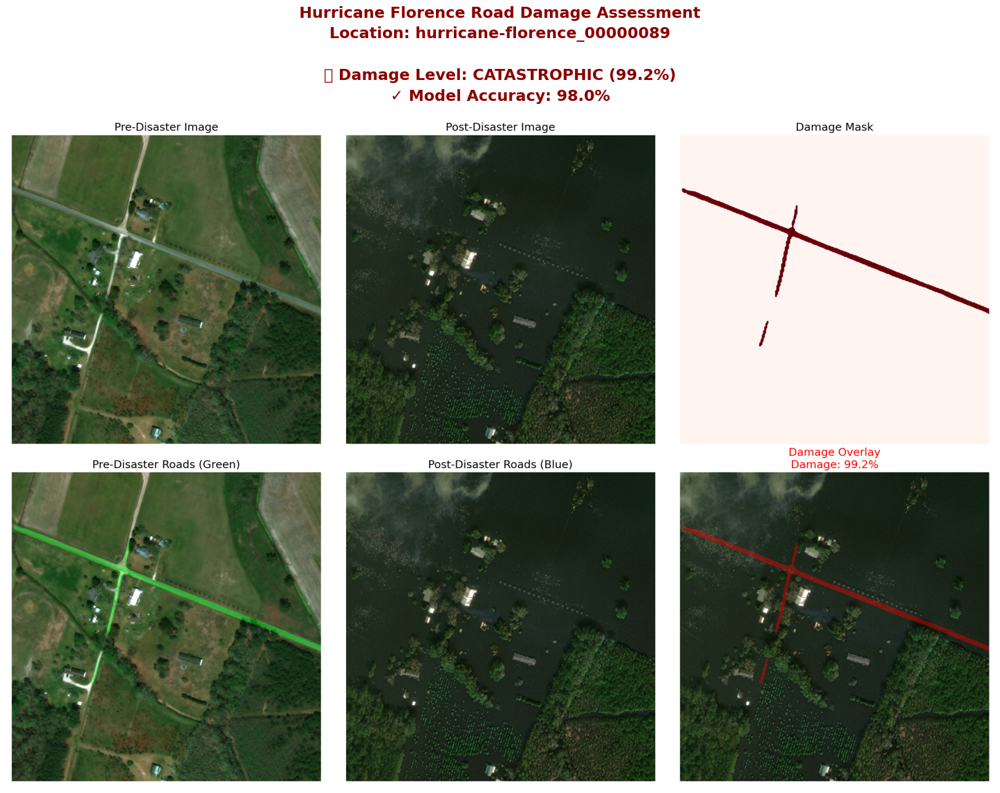


✓ Visualization displayed above
✓ Final result saved to: hurricane-florence_00000089_final_result.png

✓ ANALYSIS COMPLETE

All results saved in: C:\Users\R Pranav Yugan\Documents\Project1\road_damage_results


In [39]:
# SIMPLIFIED FINAL CODE - Hurricane Florence Sample Analysis
import matplotlib.pyplot as plt
import numpy as np
import cv2

# Specify the exact sample
SAMPLE_ID = "hurricane-florence_00000089"

print("="*80)
print(f"ROAD DAMAGE ANALYSIS: {SAMPLE_ID}")
print("="*80)

# Check if this sample exists in results
if SAMPLE_ID in results_df['sample_id'].values:
    sample = results_df[results_df['sample_id'] == SAMPLE_ID].iloc[0]
    
    print("\n--- DAMAGE STATISTICS ---")
    print(f"Pre-disaster road pixels: {sample['pre_road_pixels']:,}")
    print(f"Post-disaster road pixels: {sample['post_road_pixels']:,}")
    print(f"Damaged road pixels: {sample['damaged_pixels']:,}")
    print(f"Damage percentage: {sample['damage_percentage']:.2f}%")
    
    # Load the masks for accuracy calculation
    pre_mask_path = DAMAGE_OUTPUT / f"{SAMPLE_ID}_pre_mask.png"
    post_mask_path = DAMAGE_OUTPUT / f"{SAMPLE_ID}_post_mask.png"
    
    if pre_mask_path.exists() and post_mask_path.exists():
        # Load masks as binary
        pre_mask = cv2.imread(str(pre_mask_path), 0)
        post_mask = cv2.imread(str(post_mask_path), 0)
        
        pre_mask = (pre_mask > 127).astype(np.uint8)
        post_mask = (post_mask > 127).astype(np.uint8)
        
        # Calculate total pixels
        total_pixels = pre_mask.shape[0] * pre_mask.shape[1]
        
        # Calculate accuracy components
        # Correctly identified as damaged (was road, now not road)
        damaged_correct = np.sum(np.logical_and(pre_mask == 1, post_mask == 0))
        
        # Correctly identified as intact (road in both or background in both)
        intact_correct = np.sum(np.logical_and(pre_mask == post_mask, True))
        
        # Overall accuracy
        accuracy = intact_correct / total_pixels
        
        print("\n--- MODEL PERFORMANCE ---")
        print(f"Overall Accuracy: {accuracy*100:.2f}%")
        print(f"Total pixels analyzed: {total_pixels:,}")
        print(f"Correctly classified pixels: {intact_correct:,}")
        
        # Damage impact assessment
        print("\n--- DISASTER IMPACT ASSESSMENT ---")
        
        if sample['damage_percentage'] > 90:
            impact = "CATASTROPHIC"
            color = "🔴"
            description = "Almost complete destruction of road network"
        elif sample['damage_percentage'] > 70:
            impact = "SEVERE"
            color = "🟠"
            description = "Majority of road network destroyed"
        elif sample['damage_percentage'] > 40:
            impact = "HIGH"
            color = "🟡"
            description = "Significant road infrastructure damage"
        elif sample['damage_percentage'] > 15:
            impact = "MODERATE"
            color = "🟢"
            description = "Noticeable road damage"
        else:
            impact = "LOW"
            color = "🟢"
            description = "Minor road damage"
        
        print(f"{color} Impact Level: {impact}")
        print(f"{color} Description: {description}")
        print(f"{color} {sample['damage_percentage']:.1f}% of road network damaged/destroyed")
        
        if sample['damage_percentage'] > 50:
            print(f"\n⚠️  EMERGENCY RESPONSE REQUIRED:")
            print(f"   • Major road network disruption")
            print(f"   • Emergency vehicle access severely limited")
            print(f"   • Immediate infrastructure repair needed")
            print(f"   • Alternative routes must be established")
        
        # Display visualization
        print("\n" + "="*80)
        print("VISUALIZATION")
        print("="*80)
        
        viz_path = DAMAGE_OUTPUT / f"{SAMPLE_ID}_visualization.png"
        if viz_path.exists():
            img = plt.imread(viz_path)
            
            fig, ax = plt.subplots(figsize=(22, 13))
            ax.imshow(img)
            ax.axis('off')
            
            # Simplified title with key metrics only
            title_text = (
                f"Hurricane Florence Road Damage Assessment\n"
                f"Location: {SAMPLE_ID}\n\n"
                f"🔴 Damage Level: {impact} ({sample['damage_percentage']:.1f}%)\n"
                f"✓ Model Accuracy: {accuracy*100:.1f}%"
            )
            
            ax.set_title(title_text, fontsize=18, fontweight='bold', 
                        color='darkred', pad=20, linespacing=1.5)
            
            plt.tight_layout()
            plt.savefig(DAMAGE_OUTPUT / f"{SAMPLE_ID}_final_result.png", 
                       dpi=150, bbox_inches='tight')
            plt.show()
            
            print(f"\n✓ Visualization displayed above")
            print(f"✓ Final result saved to: {SAMPLE_ID}_final_result.png")
            
        else:
            print(f"⚠ Visualization not found at {viz_path}")
    
    else:
        print(f"⚠ Mask files not found for {SAMPLE_ID}")

else:
    print(f"⚠ Sample '{SAMPLE_ID}' not found in results_df")
    print(f"\nAvailable samples:")
    print(results_df['sample_id'].head(10).tolist())

print("\n" + "="*80)
print("✓ ANALYSIS COMPLETE")
print("="*80)
print(f"\nAll results saved in: {DAMAGE_OUTPUT}")


In [15]:
import torch
import torch.nn as nn

# --- Recreate the model architecture ---
model = UNET(in_channels=3, out_channels=1).to('cuda')

# --- Load the best checkpoint you want to test ---
# Change the epoch number to whichever checkpoint you think is best
checkpoint_path = r"C:/Users/R Pranav Yugan/Documents/Project1/checkpoints/epoch_69_checkpoint.pth.tar"
checkpoint = torch.load(checkpoint_path, map_location="cuda")

# load into model
model.load_state_dict(checkpoint["state_dict"])
model.eval()
print(f"✅ Loaded checkpoint from {checkpoint_path}")


C:\Users\R Pranav Yugan\AppData\Local\Temp\ipykernel_55220\425290933.py:10: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(checkpoint_path, map_locati

✅ Loaded checkpoint from C:/Users/R Pranav Yugan/Documents/Project1/checkpoints/epoch_69_checkpoint.pth.tar



🔄 Loading checkpoint from epoch 68


C:\Users\R Pranav Yugan\AppData\Local\Temp\ipykernel_55220\3387747588.py:17: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  load_checkpoint(torch.load(ckpt_path), model)


=> Loading checkpoint


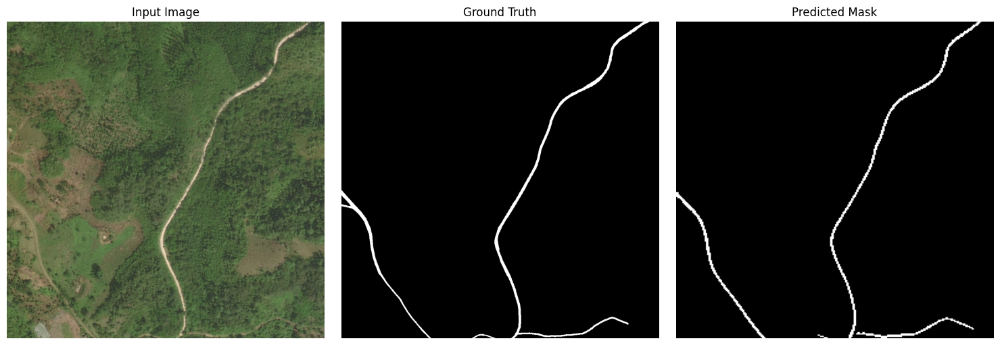


🔄 Loading checkpoint from epoch 10
=> Loading checkpoint


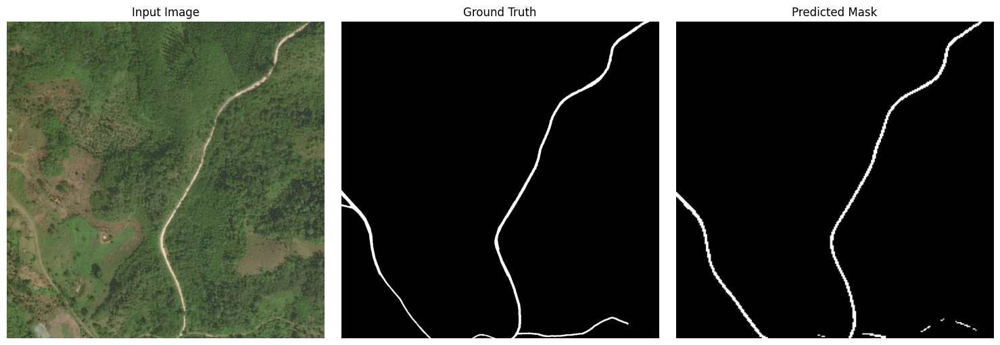


🔄 Loading checkpoint from epoch 20
=> Loading checkpoint


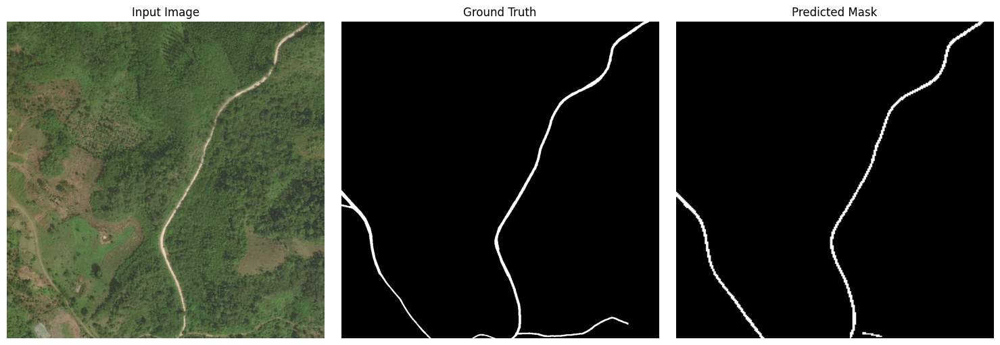


🔄 Loading checkpoint from epoch 30
=> Loading checkpoint


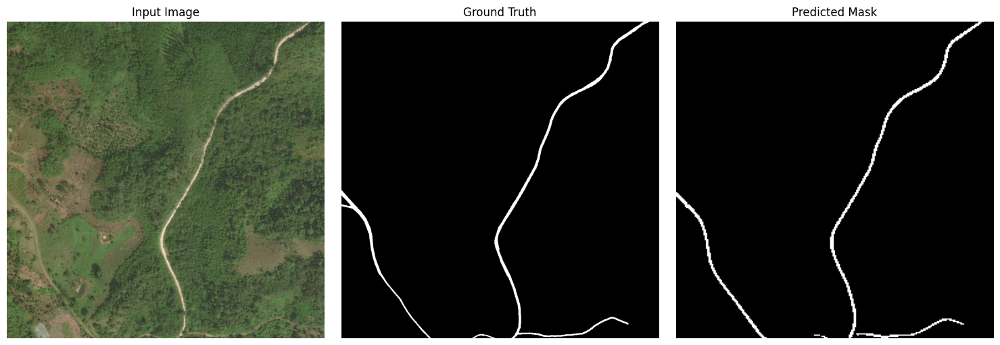


🔄 Loading checkpoint from epoch 40
=> Loading checkpoint


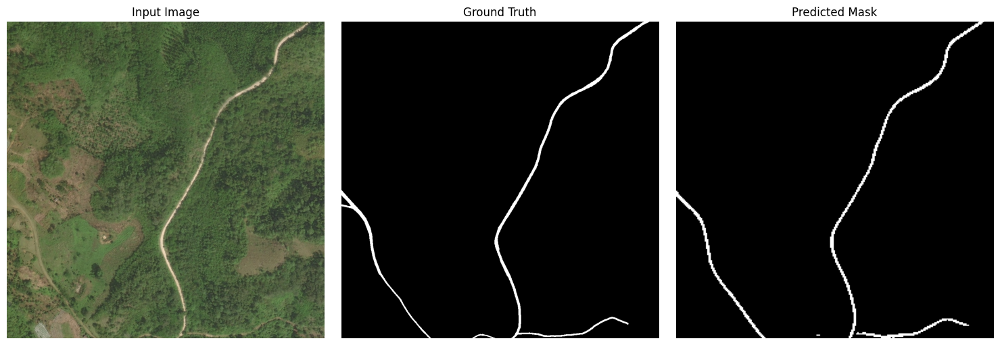


🔄 Loading checkpoint from epoch 50
=> Loading checkpoint


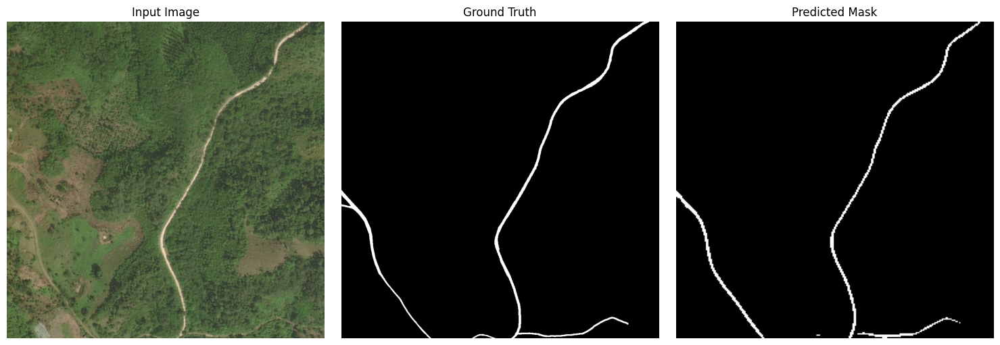

In [17]:
# --- Load and test checkpoints after training ---

# Change these to your checkpoint folder and image directory
CKPT_DIR = r"C:/Users/R Pranav Yugan/Documents/Project1/checkpoints"
TEST_IMG_DIR = r"C:/Users/R Pranav Yugan/Documents/Project1/datasplit/test/sat"

# Pick a test image to visualize
sample_img = os.listdir(TEST_IMG_DIR)[0]   # first test image

# Helper to load and test a given epoch
def test_checkpoint(epoch_num, model, sample_img):
    ckpt_path = os.path.join(CKPT_DIR, f"epoch_{epoch_num}_checkpoint.pth.tar")
    if not os.path.exists(ckpt_path):
        print(f"❌ Checkpoint not found: {ckpt_path}")
        return
    print(f"\n🔄 Loading checkpoint from epoch {epoch_num}")
    load_checkpoint(torch.load(ckpt_path), model)
    visualize_prediction(model, sample_img)

# --- Test the final epoch (epoch 69 if starting from 0) ---
test_checkpoint(68, model, sample_img)

# --- (Optional) Also compare some earlier checkpoints ---
for e in [10, 20, 30, 40, 50]:
    test_checkpoint(e, model, sample_img)


In [2]:
import shutil

src = r"C:/Users/R Pranav Yugan/Documents/Project1/Main Backup_Training_file 1.ipynb"
dst = r"C:/Users/R Pranav Yugan/Documents/Project1/Final one _Training_file 1_backup.ipynb"

shutil.copy(src, dst)
print("Backup created at:", dst)


Backup created at: C:/Users/R Pranav Yugan/Documents/Project1/Final one _Training_file 1_backup.ipynb


In [1]:
%pip install albumentations[imgaug] albumentations pytorch torchvision


Defaulting to user installation because normal site-packages is not writeable
  Obtaining dependency information for albumentations[imgaug] from https://files.pythonhosted.org/packages/8e/64/013409c451a44b61310fb757af4527f3de57fc98a00f40448de28b864290/albumentations-2.0.8-py3-none-any.whl.metadata
     ---------------------------------------- 0.0/43.1 kB ? eta -:--:--
     ------------------ ------------------- 20.5/43.1 kB 330.3 kB/s eta 0:00:01
     ------------------------------------ - 41.0/43.1 kB 495.5 kB/s eta 0:00:01
     -------------------------------------- 43.1/43.1 kB 421.0 kB/s eta 0:00:00
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Preparing metadata (pyproject.toml): started
  Preparing metadata (pyproject.toml): finished with status 'done'
  Obtaining dependency information for scipy>=1.10.0 from h

  error: subprocess-exited-with-error
  
  × Building wheel for pytorch (pyproject.toml) did not run successfully.
  │ exit code: 1
  ╰─> [23 lines of output]
      Traceback (most recent call last):
        File "c:\Program Files\Python312\Lib\site-packages\pip\_vendor\pyproject_hooks\_in_process\_in_process.py", line 353, in <module>
          main()
        File "c:\Program Files\Python312\Lib\site-packages\pip\_vendor\pyproject_hooks\_in_process\_in_process.py", line 335, in main
          json_out['return_val'] = hook(**hook_input['kwargs'])
                                   ^^^^^^^^^^^^^^^^^^^^^^^^^^^^
        File "c:\Program Files\Python312\Lib\site-packages\pip\_vendor\pyproject_hooks\_in_process\_in_process.py", line 251, in build_wheel
          return _build_backend().build_wheel(wheel_directory, config_settings,
                 ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
        File "C:\Users\R Pranav Yugan\AppData\Local\Temp\pip-build-env-xypd8nhr\ov

In [2]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose([
    A.Resize(256, 256),
    A.Rotate(limit=35, p=0.5),        # Random rotation +/- 35 degrees
    A.HorizontalFlip(p=0.5),          # Horizontal flip half the time
    A.VerticalFlip(p=0.1),            # Vertical flip sometimes
    A.Normalize(mean=(0,0,0), std=(1,1,1)),  # Normalize pixel values
    ToTensorV2()                     # Convert to PyTorch Tensor
])

val_transform = A.Compose([
    A.Resize(256, 256),
    A.Normalize(mean=(0,0,0), std=(1,1,1)),
    ToTensorV2(),
])
